<a href="https://colab.research.google.com/github/UT-GEOML/GEO398D/blob/main/08-GrainDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# Segmenting images of grains using a U-Net model




## Introduction

Although transformer-based neural networks have become very useful and popular not just in LLMs, but computer vision problems as well, CNNs are still widely used for image classification and segmentation, and are especially important in the geosciences where image-like data structures are common.

In this session, we will revisit **semantic segmentation**, using a different geoscience problem and a different dataset: we will train a U-Net-style convolutional neural network to segment grains in images of grain-like objects. The goal is to look at the question whether it is possible to train a model that works on a variety of image/grain types.

Along the way, we want to explore the following topics:
* patch-based segmentation
* data augmentation, using a dedicated tool
* using unbalanced classes
* fixing edge effects during prediction
* post-processing to label grains and compute properties

This notebook is a simplified version of part of the [segmenteverygrain](https://github.com/zsylvester/segmenteverygrain) package, which uses a U-Net model to generate prompts for a transformer-based, more generic segmentation model called [Segment Anything (SAM)](https://github.com/facebookresearch/segment-anything).

## Examples of images that are included in the training data

Sand under the microscope

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/2346_image.png">

The segmentation mask for the same image. There are three classes, marked with the labels 0 (background), 1 (grain), 2 (grain boundary).

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/2346_mask_visible.png">

Suevite (breccia that consists of melted material and rock fragments that formed during an impact), Chicxulub Crater, Mexico

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/364_77_A_072_R_002_scanA67_2_image.png" height="800">

Suevite (breccia that consists of melted material and rock fragments that formed during an impact), Chicxulub Crater, Mexico

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/364_77_A_072_R_002_scanA67_2_mask_visible.png" height = "800">

Sandstone in thin section under the microscope (Permian Basin, West Texas)

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/6801_20x_ppl_test_image.jpg">

Zircon grains mounted for age dating using a mass spectrometer

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/ET19TM_15_image.png">

Conglomerate in an outcrop (Cretaceous, Bucegi Mountains / Carpathians, Romania)

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/bucegi_conglomerate_1_image.jpg">

## Download data

The images and masks that we will be using are available at https://drive.google.com/file/d/14eTmRG8y_qts-9SYXzD1wBF6iMsvp5UN/view?usp=sharing.

In [1]:
import gdown
gdown.download('https://drive.google.com/uc?id=14eTmRG8y_qts-9SYXzD1wBF6iMsvp5UN', 'images.zip')

Downloading...
From (original): https://drive.google.com/uc?id=14eTmRG8y_qts-9SYXzD1wBF6iMsvp5UN
From (redirected): https://drive.google.com/uc?id=14eTmRG8y_qts-9SYXzD1wBF6iMsvp5UN&confirm=t&uuid=99b3b767-7775-4f54-990e-020f7f8ca25a
To: /content/images.zip
100%|██████████| 276M/276M [00:01<00:00, 266MB/s]


'images.zip'

In [2]:
!unzip images.zip

Archive:  images.zip
replace images/buckskin_gulch_3_image.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: images/buckskin_gulch_3_image.png  
  inflating: __MACOSX/images/._buckskin_gulch_3_image.png  
  inflating: images/Cal_15_mask.png  
  inflating: __MACOSX/images/._Cal_15_mask.png  
  inflating: images/2346_image.png   
  inflating: __MACOSX/images/._2346_image.png  
  inflating: images/2_1_image.png    
  inflating: __MACOSX/images/._2_1_image.png  
  inflating: images/12CCR08_mosaic_image.png  
  inflating: __MACOSX/images/._12CCR08_mosaic_image.png  
  inflating: images/IMG_5213_mask.png  
  inflating: __MACOSX/images/._IMG_5213_mask.png  
  inflating: images/364_77_A_072_R_002_scanA67_2_image.png  
  inflating: __MACOSX/images/._364_77_A_072_R_002_scanA67_2_image.png  
  inflating: images/.DS_Store        
  inflating: __MACOSX/images/._.DS_Store  
  inflating: images/chicxulub_test_mask.png  
  inflating: __MACOSX/images/._chicxulub_test_mask.png  
  inflating: ima

## Break large images into patches

In the last session, we used 2000 patches of 128 x 128 pixels that were generated using a forward model of faulted stratigraphy. We loaded the entire training set into memory and trained a U-Net model that had no predefined input and output sizes (the size defintion in the model was (None, None, None, 1)).

In many cases, we are dealing with image datasets that consist of relatively large images of variable sizes. In theory, we could use these directly as inputs to the training. However, there are several **advantages** to breaking up these larger images into small patches:

* creating overlapping patches multiplies the training data; it is a great way to do data augmentation
* in each epoch, a larger number of images are passed through the model, which also means that there are more gradient updates per epoch; this means faster convergence
* the model doesn't learn details specific to the large images (e.g., there is a large object in the lower left corner); it generalizes better
* can work with large images that wouldn't fit in memory
* batches are more likely to be balanced, with representative class distributions
* patches can be processed in parallel

These advantages usually outweigh the **disadvantages**:

* patches may not capture large-scale patterns (in this case, they should be large enough to capture at laest a few grains)
* boundary artifacts are likely to be present at inference (can use 'blending' to fix this; see below)
* implementation is more complicated

The original U-Net model (Ronneberger et al., 2015) relied on patch-based segmentation. In this session, we will go through the entire workflow of creating patches for training, training a U-Net model, and then using the model to segment a large image.

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from keras.utils import load_img
from keras.saving import load_model
from tqdm import tqdm
from skimage.util import view_as_windows
import os

def patchify_training_data(input_dir, patch_dir, patch_size=256, stride=128):
    """
    Extracts patches from training images and labels, and saves them to the specified directory.

    Parameters
    ----------
    input_dir : str
        The directory containing the input images and labels.
    patch_dir : str
        The directory where the patches will be saved.

    Returns
    -------
    tuple
        A tuple containing the paths to the directories where the image patches and label patches are saved.
    """
    from skimage.util import view_as_windows

    if not os.path.exists(input_dir):
        print(f"Warning: The directory {input_dir} does not exist.")
        return

    images = sorted(glob(input_dir + "*image*"))
    labels = sorted(glob(input_dir + "*mask*"))

    if not images or not labels:
        print(f"Warning: No files containing 'image' or 'mask' found in {input_dir}.")
        return

    # Create directories for patches
    patches_dir = os.path.join(patch_dir, "Patches")
    images_dir = os.path.join(patches_dir, "images")
    labels_dir = os.path.join(patches_dir, "labels")
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)

    start_no = 0
    for image_path in tqdm(images):
        # Load the image
        img = np.array(Image.open(image_path))

        # Handle different image formats
        if len(img.shape) == 2:  # Convert grayscale to RGB
            img = np.stack((img,) * 3, axis=-1)

        # Extract patches
        patches = view_as_windows(
            img,
            (patch_size, patch_size, 3),
            step=stride
        )

        # Reshape to list of patches (flatten the first two dimensions into a single dimension)
        patches = patches.reshape(-1, patch_size, patch_size, 3)

        # Save patches
        for i, patch in enumerate(patches):
            imname = os.path.join(images_dir, f'im{start_no + i:03d}.png')
            Image.fromarray(patch.astype(np.uint8)).save(imname)

        start_no += len(patches)

    start_no = 0
    for mask_path in tqdm(labels):
        # Load the mask
        mask = np.array(Image.open(mask_path))

        # Handle different mask formats
        if len(mask.shape) == 3 and mask.shape[2] > 1:
            mask = mask[:,:,0]  # Take only first channel

        mask = mask[:,:,np.newaxis] if len(mask.shape) == 3 else mask[:,:,np.newaxis]

        # Extract patches
        patches = view_as_windows(
            mask,
            (patch_size, patch_size, 1),
            step=stride
        )

        # Reshape to list of patches (flatten the first two dimensions into a single dimension)
        patches = patches.reshape(-1, patch_size, patch_size, 1)

        # Save patches
        for i, patch in enumerate(patches):
            imname = os.path.join(labels_dir, f'im{start_no + i:03d}.png')
            Image.fromarray(patch[:,:,0].astype(np.uint8)).save(imname)

        start_no += len(patches)

    return images_dir, labels_dir

In [4]:
from PIL import Image
from glob import glob

Image.MAX_IMAGE_PIXELS = None  # Remove image size limit

input_dir = '/content/images/'
patch_dir = '/content/'
images_dir, labels_dir = patchify_training_data(input_dir, patch_dir)

100%|██████████| 36/36 [00:15<00:00,  2.26it/s]


### Check the patches

Sample 1: /content/Patches/images/im2698.png
Sample 2: /content/Patches/images/im5815.png
Sample 3: /content/Patches/images/im4679.png
Sample 4: /content/Patches/images/im4112.png
Sample 5: /content/Patches/images/im1632.png


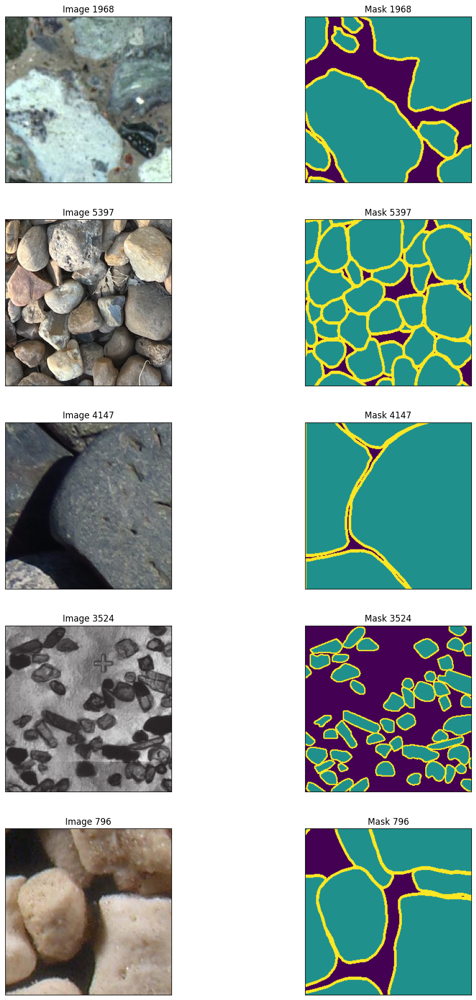

In [5]:
import cv2
import random
from glob import glob

images = sorted(glob(patch_dir + "Patches/images/*.png"))
labels = sorted(glob(patch_dir + "Patches/labels/*.png"))

# Select 5 random indices from the images list
random_indices = random.sample(range(len(images)), 5)

# Create a figure with 5 rows and 2 columns
fig, axes = plt.subplots(5, 2, figsize=(12, 20))
fig.tight_layout(pad=3.0)

# Loop through the random indices
for i, idx in enumerate(random_indices):
    # Get the image and mask filenames
    img_fname = images[idx]
    mask_fname = labels[idx]

    # Read the image and mask
    img = cv2.imread(img_fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for proper display
    mask = cv2.imread(mask_fname, cv2.IMREAD_GRAYSCALE)
    mask = mask[:,:,np.newaxis]  # Add channel dimension

    # Display the image
    axes[i, 0].imshow(img)
    axes[i, 0].set_title(f"Image {idx}")
    axes[i, 0].set_xticks([])
    axes[i, 0].set_yticks([])

    # Display the mask
    axes[i, 1].imshow(mask, vmin=0, vmax=2)
    axes[i, 1].set_title(f"Mask {idx}")
    axes[i, 1].set_xticks([])
    axes[i, 1].set_yticks([])

    # Print the filename for reference
    print(f"Sample {i+1}: {img_fname}")

plt.show()

## Create training, validation, and test datasets

In [6]:
# First randomly select a fraction of all images to use
total_subset_size = int(len(images)/8) # small enough that training takes a few minutes only
# total_subset_size = int(len(images)/1) # only use this if you are willing to wait ~40 minutes
subset_idx = np.random.choice(np.arange(len(images)), size=total_subset_size, replace=False)
subset_images = np.array(images)[subset_idx]
subset_labels = np.array(labels)[subset_idx]

# Split the subset into training (50%), validation (25%), and test (25%)
train_idx = np.random.choice(np.arange(len(subset_images)), size=int(total_subset_size/2), replace=False)
remaining_idx = np.setdiff1d(np.arange(len(subset_images)), train_idx)
val_idx = np.random.choice(remaining_idx, size=int(total_subset_size/4), replace=False)
test_idx = np.setdiff1d(remaining_idx, val_idx)

# Create arrays of training, validation, and test files
train_images = subset_images[train_idx]
val_images = subset_images[val_idx]
test_images = subset_images[test_idx]

train_masks = subset_labels[train_idx]
val_masks = subset_labels[val_idx]
test_masks = subset_labels[test_idx]

In [7]:
len(train_images)

563

## Data augmentation

Next, we want to use data augmentation to increase the size of the training set. This can be done using numpy, keras, or tensorflow; however, in this session we will be using the [`Albumentations`](https://albumentations.ai/) library. This is a dedicated library for image augmentation that provides a wide range of augmentation operations; it is fast, flexible, and well integrated with the common deep learning frameworks.

Some of the augmentation operations need to be applied only to the images (e.g., contrast, brightness), others need to be applied to both the images and the masks (e.g., flip, rotate, zoom). If we are using random augmentations, it is important that an image and the corresponding mask undergo the same transformations. `Albumentations` knows when to apply the same augmentation to both the image and the mask and when to treat them separately.

[]

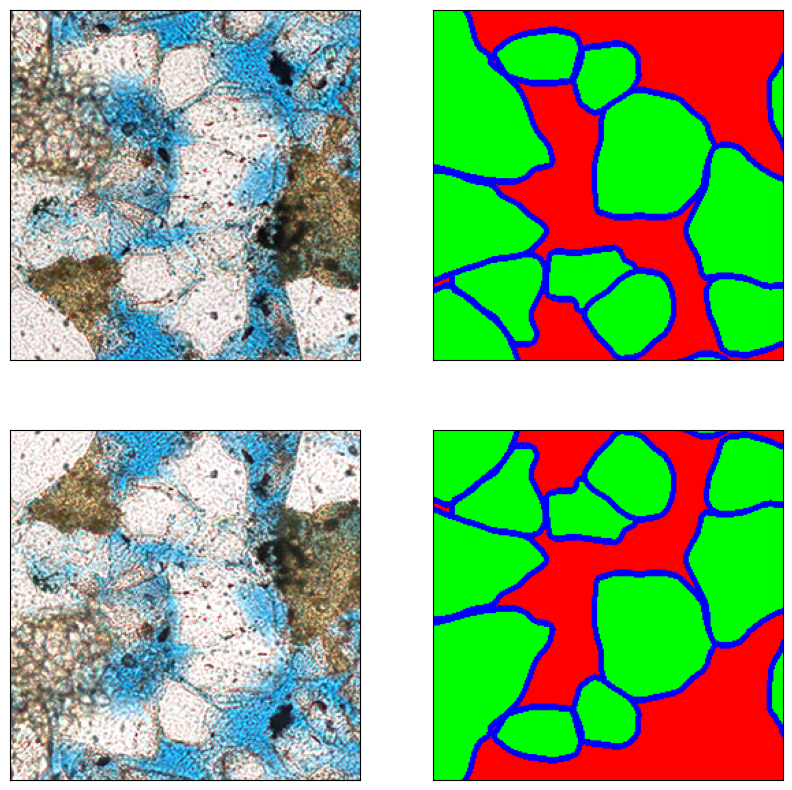

In [8]:
import albumentations as A
from PIL import Image

ind = 400
# Load image
image = np.array(Image.open(train_images[ind]))
# Load mask
mask = np.array(Image.open(train_masks[ind]))

# Convert mask to one-hot encoding
mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
for i in range(3):
    mask_one_hot[:, :, i] = (mask == i).astype(np.float32)

# Normalize image
image = image.astype(np.float32) / 255.0

# Define augmentation pipeline
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0, p=1.0),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5)
])

# Apply augmentations
augmented = transform(image=image, mask=mask_one_hot)
augmented_image = augmented['image']
augmented_mask = augmented['mask']

# Display results
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes[0, 0].imshow(image)
axes[0, 0].set_xticks([]); axes[0, 0].set_yticks([])
axes[0, 1].imshow(mask_one_hot)
axes[0, 1].set_xticks([]); axes[0, 1].set_yticks([])
axes[1, 0].imshow(augmented_image)
axes[1, 0].set_xticks([]); axes[1, 0].set_yticks([])
axes[1, 1].imshow(augmented_mask)
axes[1, 1].set_xticks([]); axes[1, 1].set_yticks([])


Let's define a `DataGenerator` class that will apply the augmentations on the fly, as we are reading the image batches from disk. We will use this class to generate training and validation batches. Doing the augmentation on the fly is more efficient than loading the entire dataset into memory or saving the augmented images to disk. Also, the augmentations are stochastic, which helps the model generalize better. We also need to define an augmentation pipeline.

In [9]:
from keras.utils import Sequence

# Define augmentation pipeline
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.7),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5)
])

class DataGenerator(Sequence): # Sequence is a keras class that is used to iterate over the data in
    def __init__(self, image_paths, mask_paths, batch_size=32, augment=True, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.batch_size = batch_size
        self.augment = augment
        if transform is not None:
            self.transform = transform
        elif augment:
            self.transform = A.Compose([
                A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.7),
                A.HorizontalFlip(p=0.5),
                A.VerticalFlip(p=0.5)
            ])
        else:
            self.transform = None

    def __len__(self):
        return len(self.image_paths) // self.batch_size

    def __getitem__(self, idx):
        batch_x = self.image_paths[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.mask_paths[idx * self.batch_size:(idx + 1) * self.batch_size]

        images = []
        masks = []

        for img_path, mask_path in zip(batch_x, batch_y):
            # Load image and mask
            image = np.array(Image.open(img_path))
            mask = np.array(Image.open(mask_path))

            # Convert mask to one-hot encoding
            mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
            for i in range(3):
                mask_one_hot[:, :, i] = (mask == i).astype(np.float32)

            # Normalize image
            image = image.astype(np.float32) / 255.0

            # Apply augmentation if enabled
            if self.augment:
                augmented = self.transform(image=image, mask=mask_one_hot)
                image = augmented['image']
                mask_one_hot = augmented['mask']

            images.append(image)
            masks.append(mask_one_hot)

        return np.array(images), np.array(masks)

In [10]:
# Create training and validation generators
train_generator = DataGenerator(
    train_images,
    train_masks,
    batch_size=32,
    augment=True,
    transform=transform
)

val_generator = DataGenerator(
    val_images,
    val_masks,
    batch_size=32,
    augment=False  # No augmentation for validation; no need to define a transform
)

In [11]:
# Get the first batch from the generator
X, y = train_generator[0]

# Print information about the output
print(f"Type of X: {type(X)}")
print(f"Shape of X: {np.shape(X)}")
print(f"Type of y: {type(y)}")
print(f"Shape of y: {y.shape}")

# Check data types and ranges
print(f"X dtype: {X.dtype if not isinstance(X, (list, dict)) else X[0].dtype if isinstance(X, list) else next(iter(X.values())).dtype}")
print(f"y dtype: {y.dtype}")
print(f"X min/max: {np.min(X)}/{np.max(X)}")
print(f"y min/max: {np.min(y)}/{np.max(y)}")

Type of X: <class 'numpy.ndarray'>
Shape of X: (32, 256, 256, 3)
Type of y: <class 'numpy.ndarray'>
Shape of y: (32, 256, 256, 3)
X dtype: float32
y dtype: float32
X min/max: 0.0/1.0
y min/max: 0.0/1.0


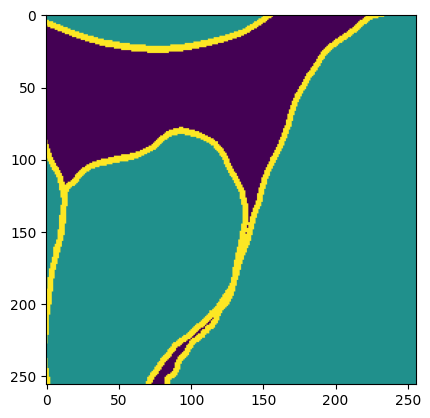

In [12]:
plt.imshow(np.argmax(y[0], axis=-1))

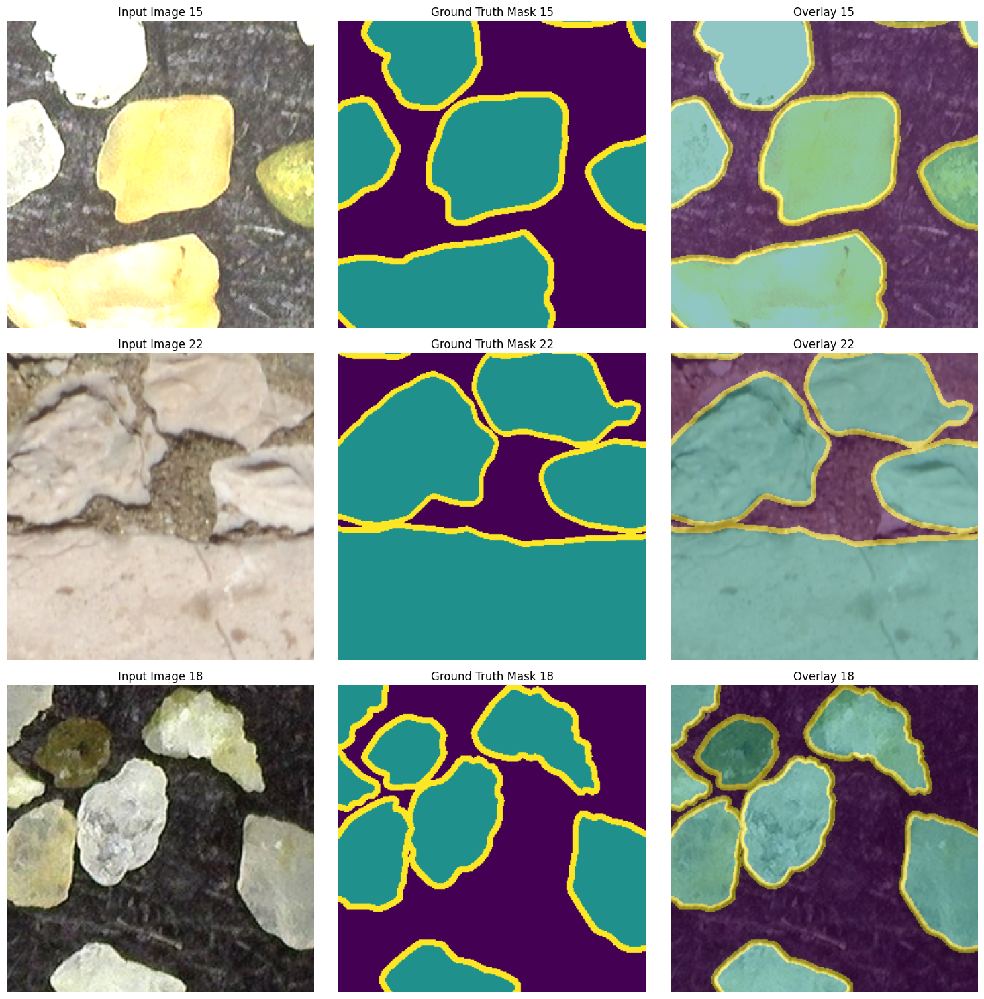

In [13]:
def visualize_generator_output(generator, num_samples=3):
    """Visualize samples from a data generator"""
    X, y = generator[0]  # Get first batch

    # Handle different input formats
    if isinstance(X, list):
        X = X[0]  # Take first element if it's a list
    elif isinstance(X, dict):
        X = next(iter(X.values()))  # Take first value if it's a dict

    # Select a few samples to display
    indices = np.random.choice(X.shape[0], min(num_samples, X.shape[0]), replace=False)

    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

    for i, idx in enumerate(indices):
        # Display input image
        axes[i, 0].imshow(X[idx])
        axes[i, 0].set_title(f"Input Image {idx}")
        axes[i, 0].axis('off')

        # Display ground truth mask (colored by class)
        mask_display = np.argmax(y[idx], axis=-1)
        axes[i, 1].imshow(mask_display, cmap='viridis')
        axes[i, 1].set_title(f"Ground Truth Mask {idx}")
        axes[i, 1].axis('off')

        # Display overlay
        axes[i, 2].imshow(X[idx])
        axes[i, 2].imshow(mask_display, alpha=0.5, cmap='viridis')
        axes[i, 2].set_title(f"Overlay {idx}")
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Use the function
visualize_generator_output(train_generator)

## Define model and loss function

For the loss function, we will use a weighted cross-entropy loss function. This is a common loss function for segmentation tasks, where the classes are imbalanced. The weights are inversely proportional to the class frequencies. In our case, the classes are imbalanced because pixels that belong to the background or the grains are much more frequent than pixels in the grain boundaries.

In [14]:
def weighted_crossentropy(y_true, y_pred):
    class_weights = tf.constant([[[[0.6, 1.0, 5.0]]]]) # increase the weight on the grains and the grain boundaries
    unweighted_losses = tf.nn.softmax_cross_entropy_with_logits(labels=y_true, logits=y_pred)
    weights = tf.reduce_sum(class_weights * y_true, axis=-1)
    weighted_losses = weights * unweighted_losses
    loss = tf.reduce_mean(weighted_losses)
    return loss

  # 0.6, 1.0, 5.0: weights for background, grain, and grain boundary classes

Now we are ready to define the U-Net model. We will use the `Conv2D` and `MaxPooling2D` layers for the encoder part, and the `Conv2DTranspose` layer for the decoder part. We will also use `BatchNormalization` layers to normalize the outputs of the convolutional layers.

In [15]:
from keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose
from keras.layers import BatchNormalization, concatenate
from keras.models import Model

def create_unet(input_shape=(256, 256, 3), filters_base=16, depth=5):
    """
    Create a U-Net model with configurable parameters.

    Parameters:
    -----------
    input_shape : tuple
        Shape of input images (height, width, channels)
    filters_base : int
        Number of filters in the first layer, doubles with each depth level
    depth : int
        Number of depth levels in the U-Net

    Returns:
    --------
    keras.Model
        Compiled U-Net model
    """
    # Clear backend
    tf.keras.backend.clear_session()

    # Input layer
    inputs = Input(input_shape)

    # Store skip connections
    skip_connections = []

    # Encoder (contracting path)
    x = inputs
    for i in range(depth):
        filters = filters_base * (2**i)

        # Two convolution layers with batch normalization
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)

        # Save for skip connection
        skip_connections.append(x)

        # Max pooling except for the last layer
        if i < depth - 1:
            x = MaxPooling2D(pool_size=(2, 2))(x)

    # Decoder (expanding path)
    for i in range(depth-2, -1, -1):
        filters = filters_base * (2**i)

        # Upsampling
        x = Conv2DTranspose(filters, (3, 3), strides=(2, 2), padding='same')(x)

        # Concatenate with skip connection
        x = concatenate([x, skip_connections[i]])

        # Two convolution layers with batch normalization
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)

    # Output layer
    outputs = Conv2D(3, (1, 1), activation='softmax')(x)

    # Create model
    model = Model(inputs=[inputs], outputs=[outputs])

    return model

We can use this function to generate U-Nets of different depths and input/output sizes, depending on what our goal is.

In [16]:
from keras.optimizers import Adam
import tensorflow as tf

# Create a standard U-Net with default parameters
# model = create_unet()

# Create a smaller U-Net for faster training
model = create_unet(filters_base=8, depth=4)

# Create a U-Net for different input dimensions
# custom_unet = create_unet(input_shape=(512, 512, 3), filters_base=32)

# Compile the model
model.compile(optimizer=Adam(), loss=weighted_crossentropy, metrics=["accuracy"])

In [17]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 256, 256, 8)    │            224 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 256, 256, 8)    │             32 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 256, 256, 8)    │            584 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 256, 256, 8)    │             32 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 128, 128, 8)    │              0 │ batch_normalization_1… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 128, 128, 16)   │          1,168 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 128, 128, 16)   │             64 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 128, 128, 16)   │          2,320 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 128, 128, 16)   │             64 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 64, 64, 16)     │              0 │ batch_normalization_3… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 64, 64, 32)     │          4,640 │ max_pooling2d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 64, 64, 32)     │            128 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 64, 64, 32)     │          9,248 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_5     │ (None, 64, 64, 32)     │            128 │ conv2d_5[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_2      

 Total params: 135,691 (530.04 KB)

 Trainable params: 134,987 (527.29 KB)

 Non-trainable params: 704 (2.75 KB)

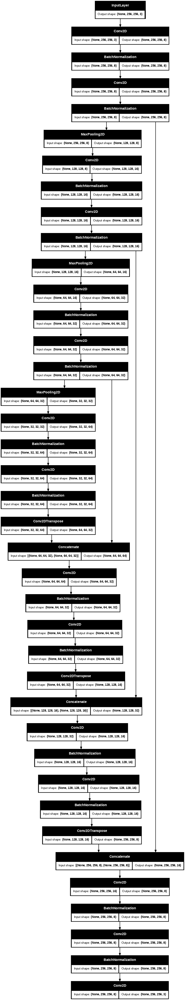

In [18]:
from keras.utils import plot_model
plot_model(model,show_shapes=True, dpi=72)

## Train and test the model

In [19]:
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=100
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(None, 256, 256, 3))
  warnings.warn(msg)


17/17 ━━━━━━━━━━━━━━━━━━━━ 32s 547ms/step - accuracy: 0.3719 - loss: 1.3096 - val_accuracy: 0.5450 - val_loss: 1.3389
Epoch 2/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 297ms/step - accuracy: 0.4296 - loss: 1.2080 - val_accuracy: 0.5039 - val_loss: 1.3334
Epoch 3/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 6s 332ms/step - accuracy: 0.4608 - loss: 1.1349 - val_accuracy: 0.5101 - val_loss: 1.3108
Epoch 4/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 299ms/step - accuracy: 0.4865 - loss: 1.1140 - val_accuracy: 0.5316 - val_loss: 1.3091
Epoch 5/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 6s 380ms/step - accuracy: 0.4916 - loss: 1.1240 - val_accuracy: 0.5310 - val_loss: 1.3141
Epoch 6/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 310ms/step - accuracy: 0.5359 - loss: 1.0796 - val_accuracy: 0.5298 - val_loss: 1.3352
Epoch 7/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 6s 331ms/step - accuracy: 0.5577 - loss: 1.0761 - val_accuracy: 0.5302 - val_loss: 1.3408
Epoch 8/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 10s 295ms/step - accuracy: 0.6007 - loss: 1.0508 - val_accuracy: 0.52

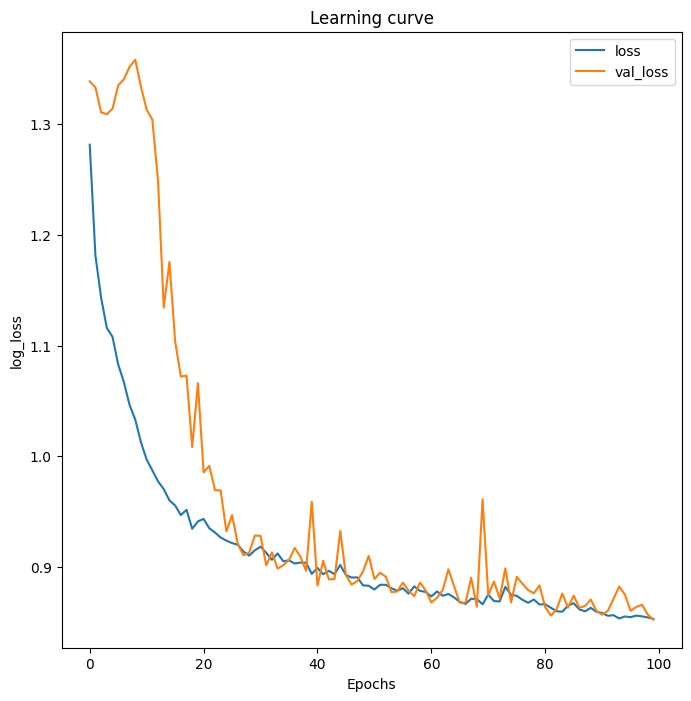

In [20]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(history.history['loss'], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

Let's have a look at the loss curve of a model that was trained on all the data and was trained for longer (200 epochs).

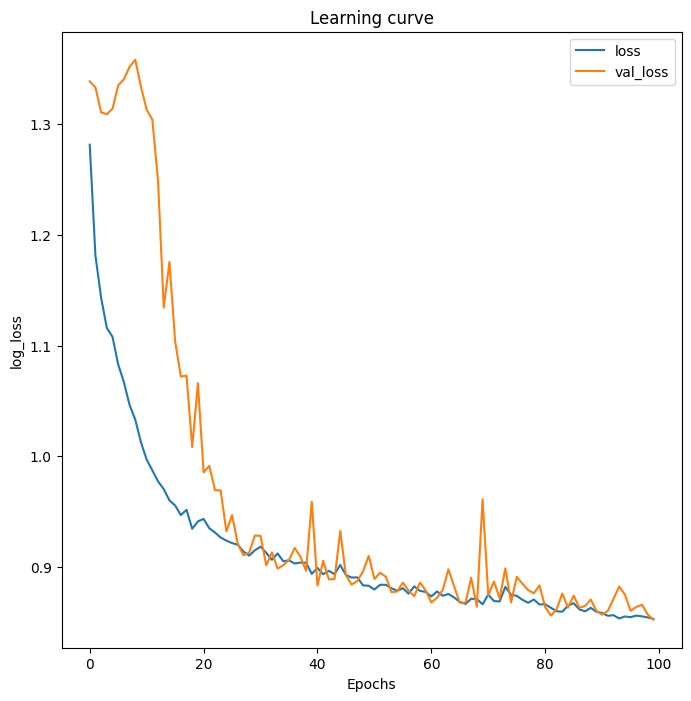

In [21]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(history.history['loss'], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

In [22]:
# Create test generator using the DataGenerator class
test_generator = DataGenerator(
    test_images,
    test_masks,
    batch_size=32,
    augment=False  # No augmentation for testing
)

# Evaluate model on test data
test_results = model.evaluate(test_generator, verbose=1)
print(f"Test Loss: {test_results[0]:.4f}")
print(f"Test Accuracy: {test_results[1]:.4f}")

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 191ms/step - accuracy: 0.8317 - loss: 0.8756
Test Loss: 0.8618
Test Accuracy: 0.8383


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(1, 256, 256, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


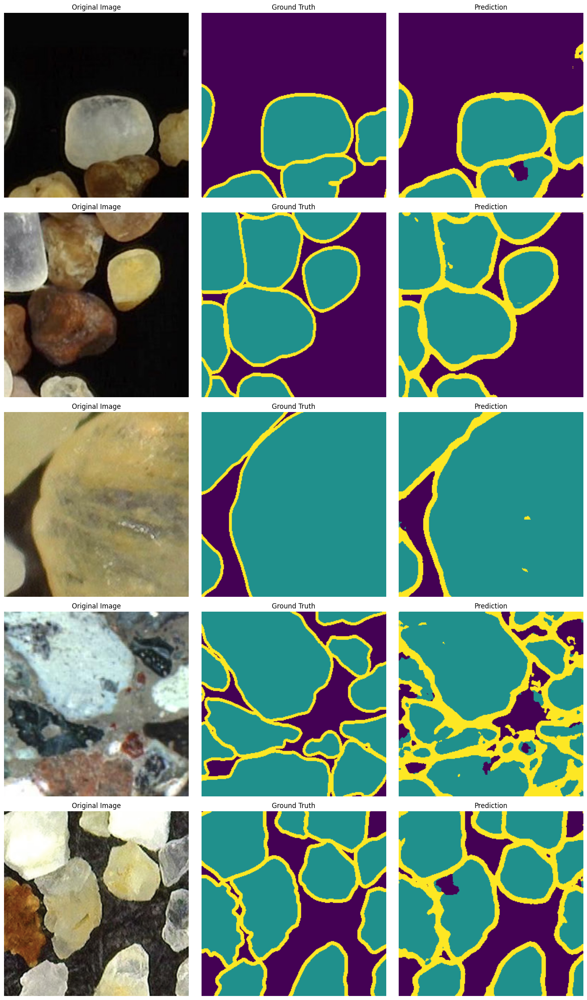

In [23]:
import matplotlib.pyplot as plt
import random

# Select a few random test images
num_samples = 5
sample_indices = random.sample(range(len(test_images)), num_samples)

# Create a figure for visualization
fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

for i, idx in enumerate(sample_indices):
    # Load image and mask
    image = np.array(Image.open(test_images[idx])).astype(np.float32) / 255.0
    mask = np.array(Image.open(test_masks[idx]))

    # Convert mask to one-hot encoding
    mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
    for c in range(3):
        mask_one_hot[:, :, c] = (mask == c).astype(np.float32)

    # Get model prediction
    image_batch = np.expand_dims(image, axis=0)
    prediction = model.predict(image_batch)[0]
    predicted_mask = np.argmax(prediction, axis=-1)

    # Display original image
    axes[i, 0].imshow(image)
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis('off')

    # Display ground truth mask
    axes[i, 1].imshow(np.argmax(mask_one_hot, axis=-1), vmin=0, vmax=2)
    axes[i, 1].set_title("Ground Truth")
    axes[i, 1].axis('off')

    # Display predicted mask
    axes[i, 2].imshow(predicted_mask, vmin=0, vmax=2)
    axes[i, 2].set_title("Prediction")
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# can save the model using 'model.save'
model.save("unet_model.keras")

Let's load a model that has been trained on all of the data and for longer. This model is available from https://drive.google.com/file/d/1Ci520xPmyuLgAloZFozVX2J354TuQdaL/view?usp=sharing.

In [24]:
gdown.download("https://drive.google.com/uc?id=1Ci520xPmyuLgAloZFozVX2J354TuQdaL", "unet_model.keras")

Downloading...
From (original): https://drive.google.com/uc?id=1Ci520xPmyuLgAloZFozVX2J354TuQdaL
From (redirected): https://drive.google.com/uc?id=1Ci520xPmyuLgAloZFozVX2J354TuQdaL&confirm=t&uuid=451b8c9a-bf22-4013-b48a-a943ea5cab63
To: /content/unet_model.keras
100%|██████████| 26.2M/26.2M [00:00<00:00, 176MB/s]


'unet_model.keras'

In [25]:
better_model = load_model("unet_model.keras", custom_objects={'weighted_crossentropy': weighted_crossentropy}) # need to tell keras to use the custom loss function

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


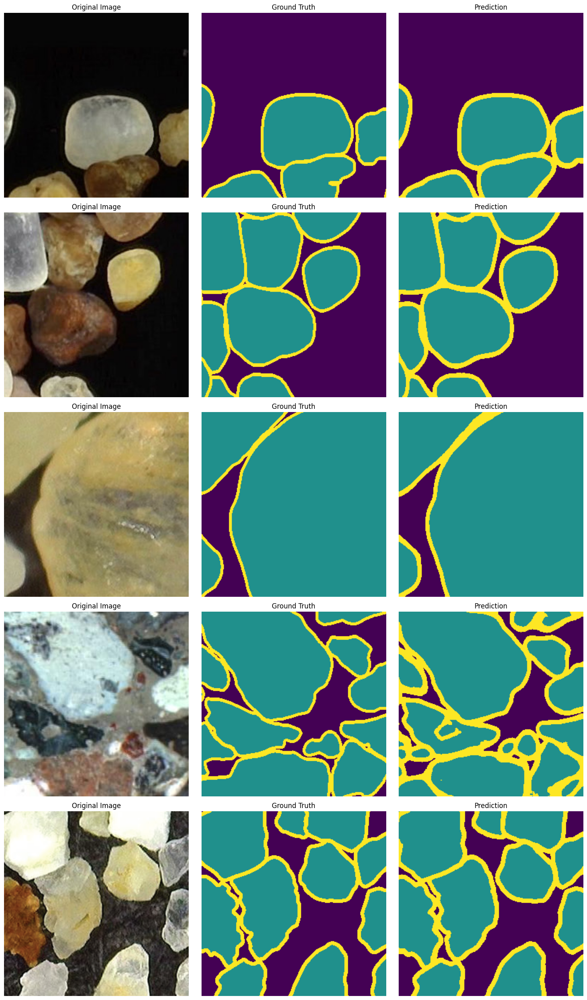

In [26]:
# Create a figure for visualization
fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

for i, idx in enumerate(sample_indices):
    # Load image and mask
    image = np.array(Image.open(test_images[idx])).astype(np.float32) / 255.0
    mask = np.array(Image.open(test_masks[idx]))

    # Convert mask to one-hot encoding
    mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
    for c in range(3):
        mask_one_hot[:, :, c] = (mask == c).astype(np.float32)

    # Get model prediction
    image_batch = np.expand_dims(image, axis=0)
    prediction = better_model.predict(image_batch)[0]
    predicted_mask = np.argmax(prediction, axis=-1)

    # Display original image
    axes[i, 0].imshow(image)
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis('off')

    # Display ground truth mask
    axes[i, 1].imshow(np.argmax(mask_one_hot, axis=-1), vmin=0, vmax=2)
    axes[i, 1].set_title("Ground Truth")
    axes[i, 1].axis('off')

    # Display predicted mask
    axes[i, 2].imshow(predicted_mask, vmin=0, vmax=2)
    axes[i, 2].set_title("Prediction")
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

## Post-processing

### Edge effects

Most images that we want to segment are much larger than 256 x 256 pixels, so we need to break them up into 256 x 256 tiles to apply the model and then reassemble the large image. However, this results in edge effects at the boundaries between the tiles, which might not be obvious at first sight, but they are definitely a problem if you want good results. In the next section we look at one way of dealing with these edge effects.

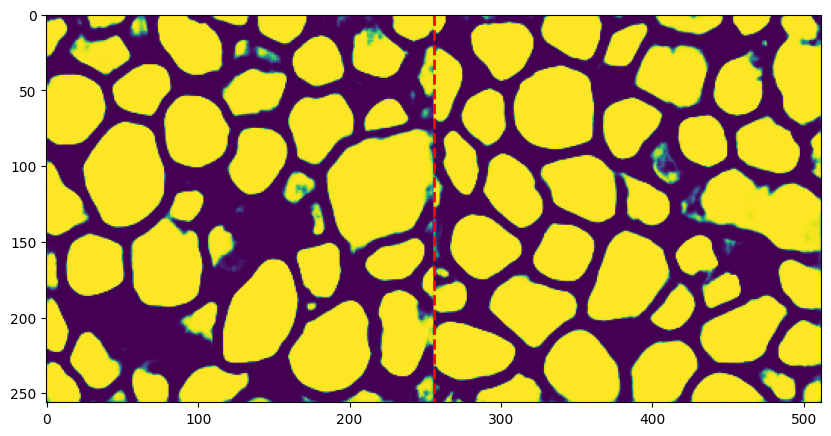

In [27]:
# function for segmenting one tile:
def predict_image_tile(im_tile, model):
    im_tile = np.expand_dims(im_tile, axis=0) # add batch dimension
    im_tile_pred = model.predict(im_tile, verbose=0) # make prediction
    im_tile_pred = im_tile_pred[0] # remove batch dimension
    return im_tile_pred

fname = '/content/images/20210705_141816733_image.png'

# load an large image and apply segmentation to two neighboring tiles:
big_im = np.array(load_img(fname))
r1 = 250
c1 = 250
im_tile = big_im[r1:r1+256, c1:c1+256]/255
im_tile_pred1 = predict_image_tile(im_tile, model) # tile 1
im_tile = big_im[r1:r1+256, c1+256:c1+2*256]/255
im_tile_pred2 = predict_image_tile(im_tile, model) # tile
im_tile_pred = np.concatenate((im_tile_pred1, im_tile_pred2), axis = 1)
fig = plt.figure(figsize = (10, 6))
plt.imshow(im_tile_pred[:,:,1])
plt.plot([256, 256], [0, 256], 'r--', linewidth = 2)
plt.ylim(256,0)
plt.show()

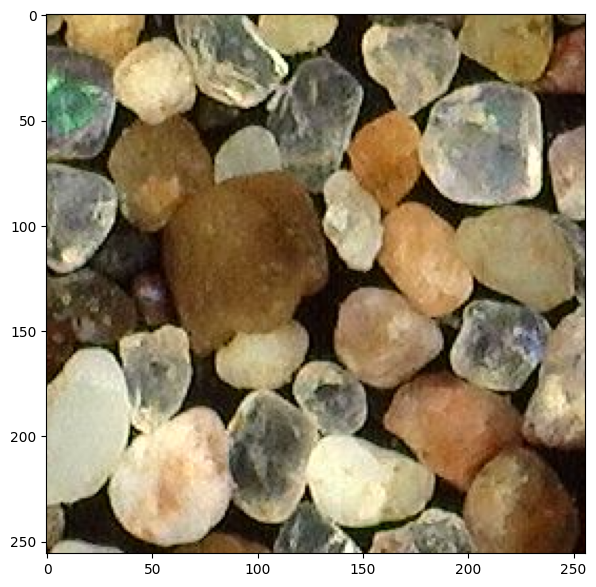

In [28]:
fig = plt.figure(figsize = (7, 7))
plt.imshow(big_im[r1:r1+256, c1+128:c1+256+128]/255);

One way to deal with these edge effects in patch-based image segmentation is to use the [Hann window function](https://en.wikipedia.org/wiki/Hann_function), often used in signal processing. See [this paper](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0229839) for more details.

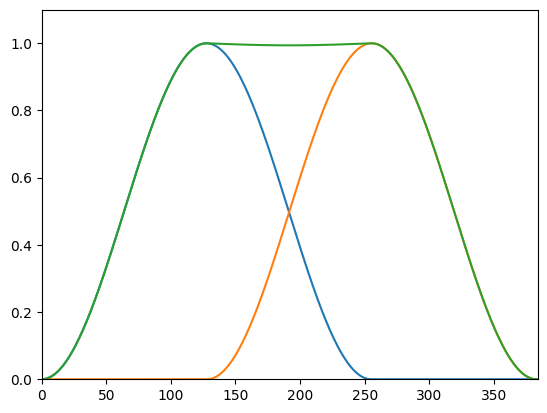

In [29]:
I = 256
han1 = np.zeros((128+256,))
han1[:256] = np.hanning(I)
han2 = np.zeros((128+256,))
han2[128:] = np.hanning(I)
plt.plot(han1)
plt.plot(han2)
plt.plot(han1 + han2)
plt.xlim(0, 256+128)
plt.ylim(0, 1.1);

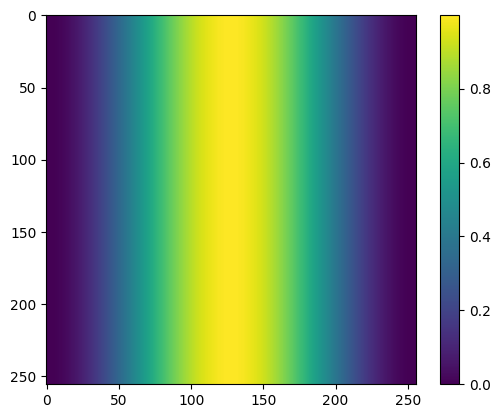

In [30]:
I = 256
W = np.tile(np.hanning(I), (I, 1))
plt.imshow(W)
plt.colorbar();

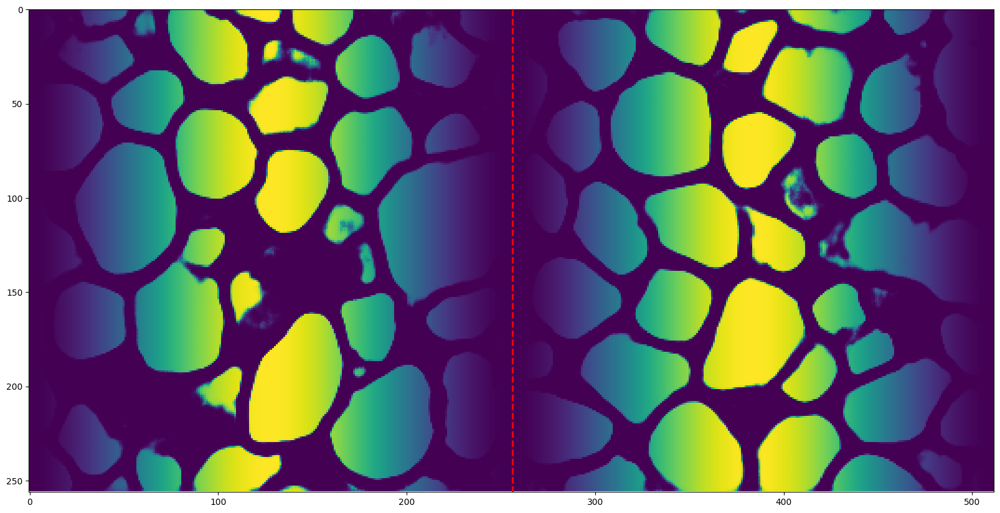

In [31]:
im_tile = big_im[r1:r1+256, c1:c1+256]/255
im_tile_pred1 = predict_image_tile(im_tile, model) # tile 1
im_tile = big_im[r1:r1+256, c1+256:c1+2*256]/255
im_tile_pred2 = predict_image_tile(im_tile, model) # tile 2
# multiply segmented tiles by Hanning window:
im_tile_pred = np.concatenate((W * im_tile_pred1[:,:,1], W * im_tile_pred2[:,:,1]), axis = 1)
fig = plt.figure(figsize = (20, 20))
plt.imshow(im_tile_pred)
plt.plot([256, 256], [0, 256], 'r--', linewidth = 2)
plt.ylim(256, 0);

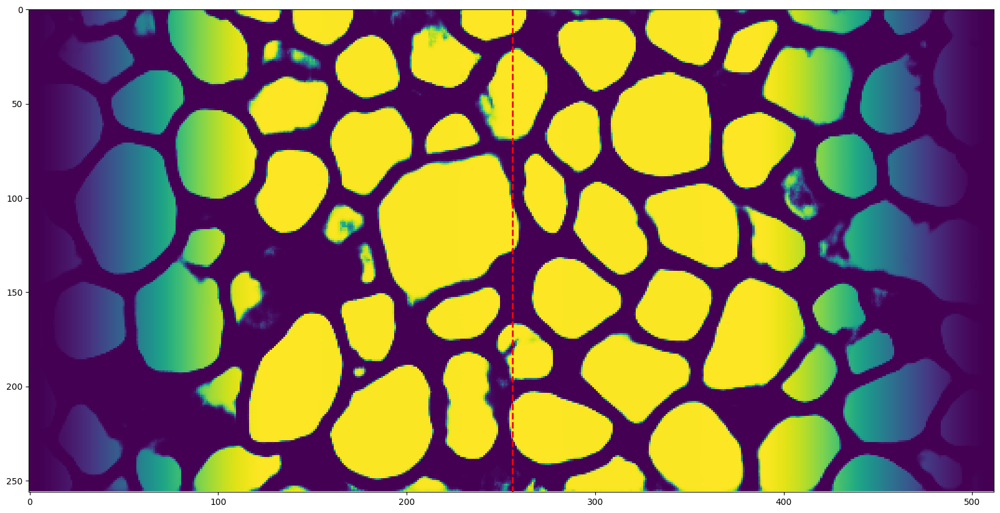

In [32]:
# edge effects
im_tile = big_im[r1:r1+256, c1:c1+256]/255
im_tile_pred1 = predict_image_tile(im_tile, model) # tile 1
im_tile = big_im[r1:r1+256, c1+256:c1+2*256]/255
im_tile_pred2 = predict_image_tile(im_tile, model) # tile 2
im_tile = big_im[r1:r1+256, c1+128:c1+384]/255
im_tile_pred3 = predict_image_tile(im_tile, model) # tile 3
# multiply segmented tiles by Hanning window:
im_tile_pred = np.concatenate((W * im_tile_pred1[:,:,1], W * im_tile_pred2[:,:,1]), axis = 1)
# add third tile to the middle of the image:
im_tile_pred[:, 128:128+256] += W * im_tile_pred3[:,:,1]
fig = plt.figure(figsize = (20, 20))
plt.imshow(im_tile_pred)
plt.plot([256, 256], [0, 256], 'r--', linewidth = 2)
plt.ylim(256, 0);

### Putting predicted tiles together

We are now able to generate tiles of good quality but we need to assemble them into the size of the original large image. We will be using the blending technique we looked at above to get rid of the edge effects.

In [33]:
from tqdm import trange

def predict_large_image(image_path, model, patch_size=256, overlap=0.5):
    """Predict segmentation for a large image using overlapping patches"""
    # Load image
    image = np.array(Image.open(image_path)).astype(np.float32) / 255.0
    if image.shape[-1] == 4:
        image = image[:,:,:3]

    # Calculate stride
    stride = int(patch_size * (1 - overlap))

    # Create empty prediction map
    h, w = image.shape[:2]
    prediction = np.zeros((h, w, 3))
    weight_map = np.zeros((h, w))

    # Create blending window
    window = np.outer(np.hanning(patch_size), np.hanning(patch_size))

    # Process overlapping patches
    for y in trange(0, h, stride):
        for x in range(0, w, stride):
            # Handle edge cases by padding if necessary
            y_end = min(y + patch_size, h)
            x_end = min(x + patch_size, w)
            y_start = max(0, y_end - patch_size)
            x_start = max(0, x_end - patch_size)

            # Extract patch
            patch = image[y_start:y_end, x_start:x_end]

            # Pad if necessary
            if patch.shape[0] < patch_size or patch.shape[1] < patch_size:
                padded_patch = np.zeros((patch_size, patch_size, patch.shape[2]))
                padded_patch[:patch.shape[0], :patch.shape[1]] = patch
                patch = padded_patch

            # Predict
            patch_pred = model.predict(np.expand_dims(patch, axis=0), verbose=0)[0]

            # Calculate window size for this patch
            window_h, window_w = y_end - y_start, x_end - x_start
            current_window = window[:window_h, :window_w]

            # Apply blending window
            for c in range(patch_pred.shape[-1]):
                prediction[y_start:y_end, x_start:x_end, c] += patch_pred[:window_h, :window_w, c] * current_window
            weight_map[y_start:y_end, x_start:x_end] += current_window

    # Normalize by weights
    for c in range(prediction.shape[-1]):
        prediction[:,:,c] /= np.maximum(weight_map, 1e-8)

    return prediction

100%|██████████| 13/13 [00:15<00:00,  1.18s/it]


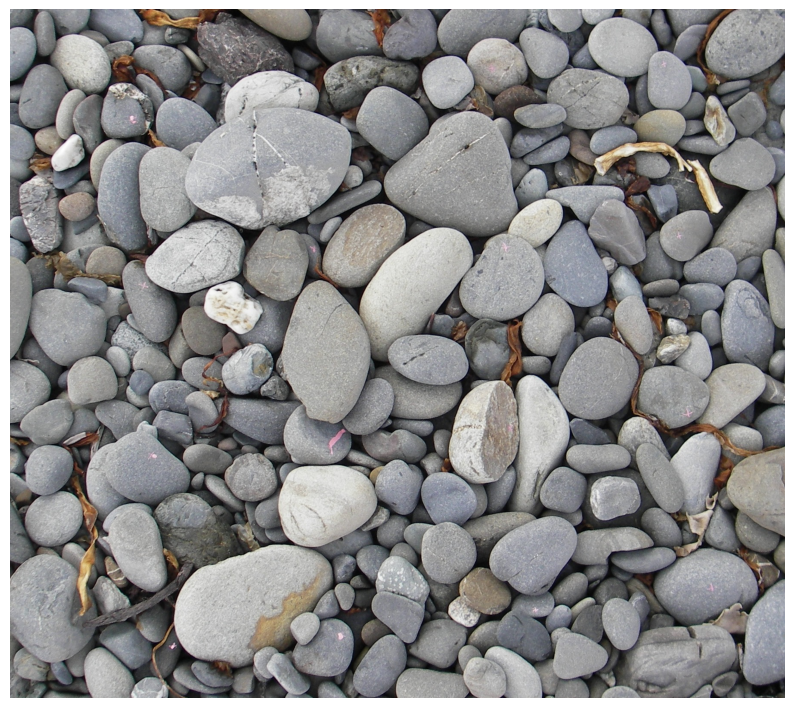

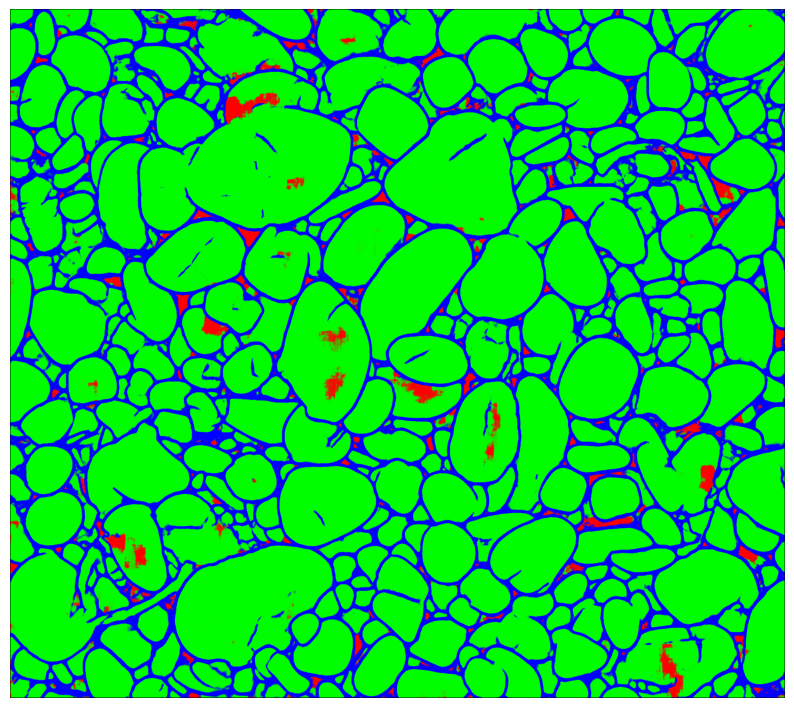

In [34]:
# fname = '/content/images/HU_image.png'
fname = '/content/images/Cal_05_image.png'

fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(np.array(Image.open(fname)))
plt.axis('off')

predicted_image = predict_large_image(fname, model)
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(predicted_image)
plt.axis('off')
plt.show()

100%|██████████| 13/13 [00:16<00:00,  1.24s/it]


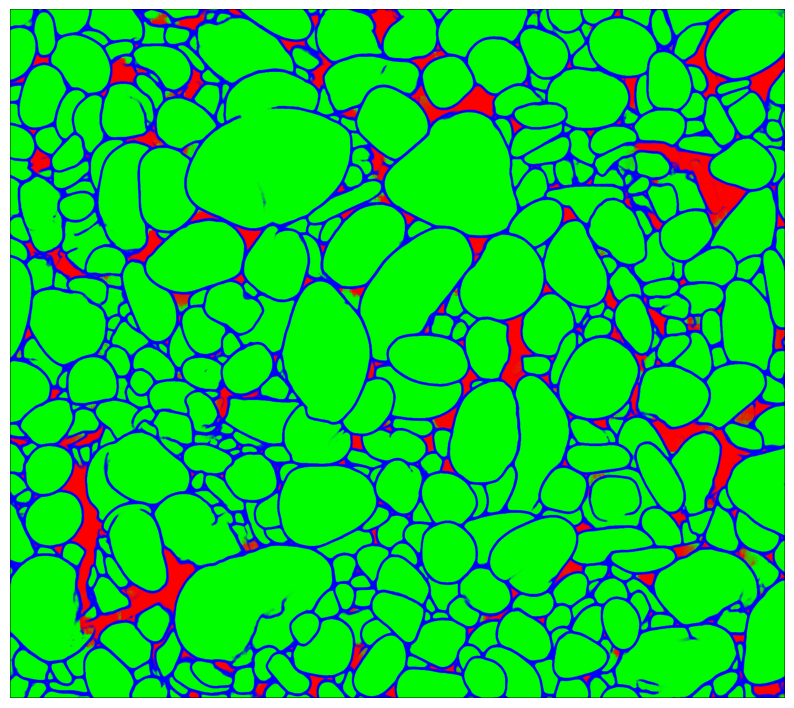

In [35]:
predicted_image = predict_large_image(fname, better_model)
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(predicted_image)
plt.axis('off')
plt.show()

### Identify individual grains (labeling)

Next we will probably want to identify individual grains. This can be done using **connected component labeling**, an algorithm in computer vision that detects connected regions in binary digital images.

Found 580 initial grain candidates
Found 457 grains after filtering
Total grains identified: 457
Average grain area: 5011.81 pixels
Average grain perimeter: 247.56 pixels


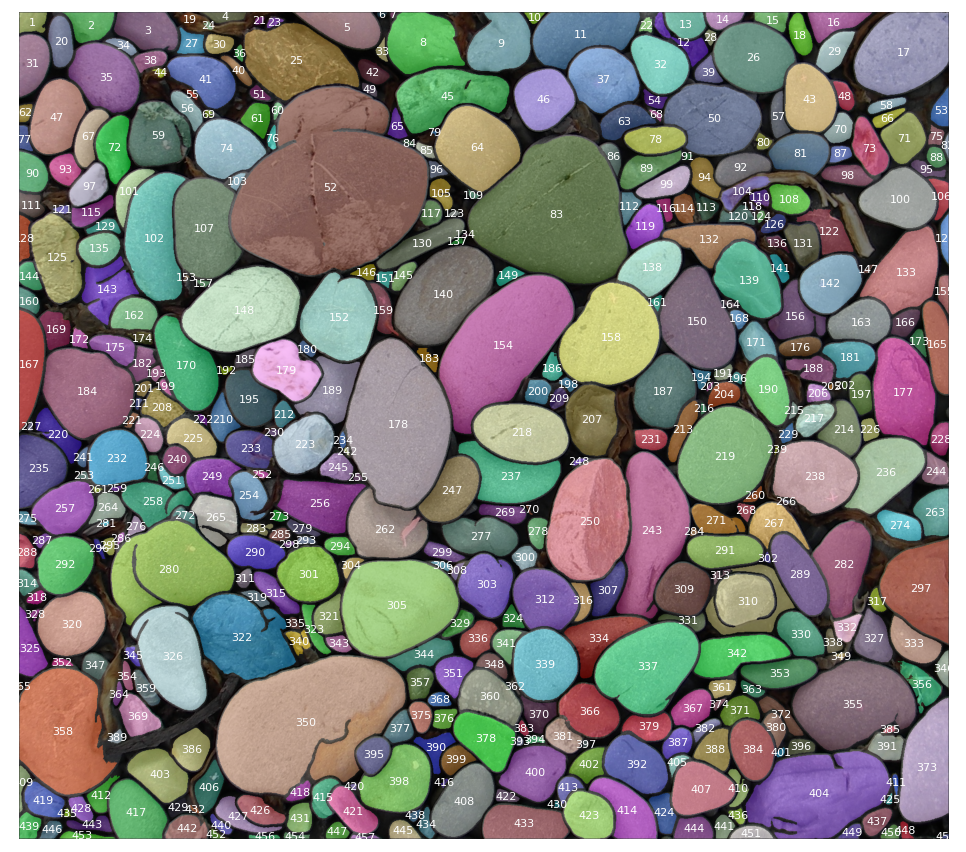

In [36]:
from skimage import measure
from skimage.measure import regionprops, regionprops_table
from matplotlib.colors import ListedColormap

def identify_grains(prediction, grain_class=1, boundary_class=2, min_grain_size=25):
    """
    Extract individual grains from segmentation prediction

    Args:
        prediction: Output from predict_large_image (HxWx3 array)
        grain_class: Index of the grain class (default: 1)
        boundary_class: Index of the boundary class (default: 2)
        min_grain_size: Minimum size of grains to keep (in pixels)

    Returns:
        labeled_grains: Image with unique integer for each grain
        grain_properties: DataFrame with grain measurements
    """
    # Get class predictions (argmax across channel dimension)
    segmentation = np.argmax(prediction, axis=-1)

    # Extract grain mask (pixels classified as grains)
    grain_mask = (segmentation == grain_class).astype(np.uint8)

    # Get boundary mask
    boundary_mask = (segmentation == boundary_class).astype(np.uint8)
    grain_mask[boundary_mask == 1] = 0

    # Label connected components (each grain gets unique integer)
    labeled_grains, num_grains = measure.label(grain_mask, return_num=True)

    print(f"Found {num_grains} initial grain candidates")

    # Filter small objects
    grain_props = regionprops(labeled_grains)
    for prop in grain_props:
        if prop.area < min_grain_size:
            labeled_grains[labeled_grains == prop.label] = 0

    # Relabel to get consecutive labels
    labeled_grains, num_grains = measure.label(labeled_grains > 0, return_num=True)

    print(f"Found {num_grains} grains after filtering")

    # Get properties of each grain
    props = regionprops_table(
        labeled_grains,
        intensity_image=prediction[:,:,grain_class],  # Use grain probability as intensity
        properties=(
            'label', 'area', 'centroid', 'orientation',
            'major_axis_length', 'minor_axis_length',
            'perimeter', 'eccentricity', 'mean_intensity'
        )
    )

    # Convert to DataFrame
    grain_properties = pd.DataFrame(props)
    return labeled_grains, grain_properties


def visualize_grains(image, labeled_grains, grain_properties):
    """Visualize identified grains"""
    # Create random colors for each grain
    n_grains = labeled_grains.max()
    colors = np.random.rand(n_grains+1, 4)  # RGBA
    colors[0] = [0, 0, 0, 0]  # Background transparent
    colors[:, 3] = 0.5  # Set alpha for all colors

    # Create colormap
    cmap = ListedColormap(colors)

    # Plot
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(image)
    ax.imshow(labeled_grains, cmap=cmap)

    # Optionally add grain IDs
    for i, row in grain_properties.iterrows():
        y, x = row['centroid-0'], row['centroid-1']
        ax.text(x, y, str(row['label'].astype(int)), color='white', fontsize=8,
                ha='center', va='center')

    plt.axis('off')
    return fig, ax


# Identify individual grains
labeled_grains, grain_properties = identify_grains(
    predicted_image,
    grain_class=1,
    boundary_class=2,
    min_grain_size=50
)

# Visualize results
original_image = np.array(Image.open(fname)).astype(np.float32) / 255.0
fig, ax = visualize_grains(original_image, labeled_grains, grain_properties)

# Print grain statistics
print(f"Total grains identified: {len(grain_properties)}")
print(f"Average grain area: {grain_properties['area'].mean():.2f} pixels")
print(f"Average grain perimeter: {grain_properties['perimeter'].mean():.2f} pixels")

In [37]:
grain_properties

,label,area,centroid-0,centroid-1,orientation,major_axis_length,minor_axis_length,perimeter,eccentricity,mean_intensity
0,1,1856.0,18.798491,25.355603,-1.455346,58.556156,43.388027,189.562446,0.671544,0.977274
1,2,4017.0,25.080906,138.247946,-1.496805,89.255086,62.556722,273.645707,0.713283,0.996312
2,3,7104.0,34.104167,248.296593,1.321330,129.581914,71.503658,357.279221,0.833975,0.995193
3,4,1163.0,8.395529,399.059329,-1.562830,80.965564,20.114782,185.219300,0.968648,0.987477
4,5,7587.0,29.503888,633.406485,1.338910,157.335759,65.905743,404.492424,0.908039,0.996844
...,...,...,...,...,...,...,...,...,...,...
452,453,839.0,1593.756853,121.045292,1.522936,104.785941,12.075269,222.526912,0.993338,0.975873
453,454,379.0,1594.432718,534.569921,1.520034,60.128016,10.008245,117.798990,0.986050,0.929563
454,455,86.0,1594.883721,1792.941860,-1.323179,13.684309,8.375183,35.449747,0.790836,0.743317
455,456,331.0,1595.616314,474.722054,-1.568818,72.024449,6.986758,129.798990,0.995284,0.961169


## Task 1

In the first iteration of training our grain segmentation model, we used (1) a limited number of training patches, and (2) a limited number of transformations to do data augmentation. Your task is to improve the model accuracy and generality by
* (a) increasing the number of training patches, and
* (b) adding a larger variety of transformations (using the [Albumentations](https://albumentations.ai/) library).

Tip: to do the augmentations, experiment first with a limited number of patches so that it doesn't take too long and you don't use up your Google Colab compute allocation.

In [38]:
# First randomly select a fraction of all images to use
total_subset_size = int(len(images)/2) # small enough that training takes a few minutes only
# total_subset_size = int(len(images)/1) # only use this if you are willing to wait ~40 minutes
subset_idx = np.random.choice(np.arange(len(images)), size=total_subset_size, replace=False)
subset_images = np.array(images)[subset_idx]
subset_labels = np.array(labels)[subset_idx]

# Split the subset into training (50%), validation (25%), and test (25%)
train_idx = np.random.choice(np.arange(len(subset_images)), size=int(total_subset_size/2), replace=False)
remaining_idx = np.setdiff1d(np.arange(len(subset_images)), train_idx)
val_idx = np.random.choice(remaining_idx, size=int(total_subset_size/4), replace=False)
test_idx = np.setdiff1d(remaining_idx, val_idx)

# Create arrays of training, validation, and test files
train_images = subset_images[train_idx]
val_images = subset_images[val_idx]
test_images = subset_images[test_idx]

train_masks = subset_labels[train_idx]
val_masks = subset_labels[val_idx]
test_masks = subset_labels[test_idx]

In [ ]:
len(train_images)

2255

Transformations added: Scaling, Shifting, Rotating, Sharpening

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


[]

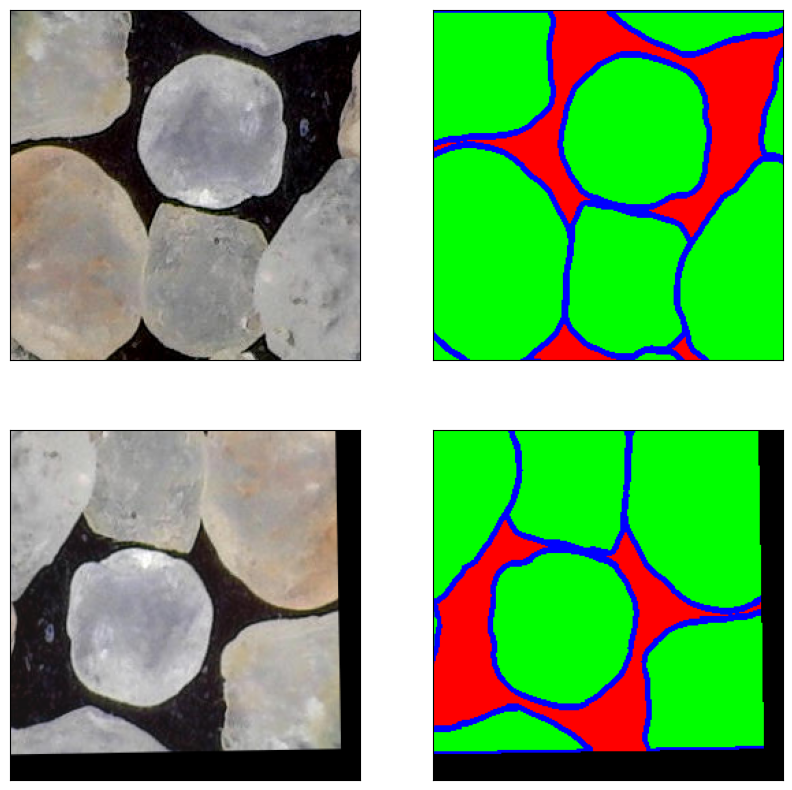

In [39]:
import albumentations as A
from PIL import Image

ind = 400
# Load image
image = np.array(Image.open(train_images[ind]))
# Load mask
mask = np.array(Image.open(train_masks[ind]))

# Convert mask to one-hot encoding
mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
for i in range(3):
    mask_one_hot[:, :, i] = (mask == i).astype(np.float32)

# Normalize image
image = image.astype(np.float32) / 255.0

# Define augmentation pipeline
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0, p=1.0),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5), A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=45, p=1.0), A.Sharpen(p=0.5),
])

# Apply augmentations
augmented = transform(image=image, mask=mask_one_hot)
augmented_image = augmented['image']
augmented_mask = augmented['mask']

# Display results
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes[0, 0].imshow(image)
axes[0, 0].set_xticks([]); axes[0, 0].set_yticks([])
axes[0, 1].imshow(mask_one_hot)
axes[0, 1].set_xticks([]); axes[0, 1].set_yticks([])
axes[1, 0].imshow(augmented_image)
axes[1, 0].set_xticks([]); axes[1, 0].set_yticks([])
axes[1, 1].imshow(augmented_mask)
axes[1, 1].set_xticks([]); axes[1, 1].set_yticks([])

In [40]:
from keras.utils import Sequence

# Define augmentation pipeline
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.7),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5)
])

class DataGenerator(Sequence): # Sequence is a keras class that is used to iterate over the data in
    def __init__(self, image_paths, mask_paths, batch_size=32, augment=True, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.batch_size = batch_size
        self.augment = augment
        if transform is not None:
            self.transform = transform
        elif augment:
            self.transform = A.Compose([
                A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.7),
                A.HorizontalFlip(p=0.5),
                A.VerticalFlip(p=0.5)
            ])
        else:
            self.transform = None

    def __len__(self):
        return len(self.image_paths) // self.batch_size

    def __getitem__(self, idx):
        batch_x = self.image_paths[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.mask_paths[idx * self.batch_size:(idx + 1) * self.batch_size]

        images = []
        masks = []

        for img_path, mask_path in zip(batch_x, batch_y):
            # Load image and mask
            image = np.array(Image.open(img_path))
            mask = np.array(Image.open(mask_path))

            # Convert mask to one-hot encoding
            mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
            for i in range(3):
                mask_one_hot[:, :, i] = (mask == i).astype(np.float32)

            # Normalize image
            image = image.astype(np.float32) / 255.0

            # Apply augmentation if enabled
            if self.augment:
                augmented = self.transform(image=image, mask=mask_one_hot)
                image = augmented['image']
                mask_one_hot = augmented['mask']

            images.append(image)
            masks.append(mask_one_hot)

        return np.array(images), np.array(masks)

In [41]:
# Create training and validation generators
train_generator = DataGenerator(
    train_images,
    train_masks,
    batch_size=32,
    augment=True,
    transform=transform
)

val_generator = DataGenerator(
    val_images,
    val_masks,
    batch_size=32,
    augment=False  # No augmentation for validation; no need to define a transform
)

In [42]:
# Get the first batch from the generator
X, y = train_generator[0]

# Print information about the output
print(f"Type of X: {type(X)}")
print(f"Shape of X: {np.shape(X)}")
print(f"Type of y: {type(y)}")
print(f"Shape of y: {y.shape}")

# Check data types and ranges
print(f"X dtype: {X.dtype if not isinstance(X, (list, dict)) else X[0].dtype if isinstance(X, list) else next(iter(X.values())).dtype}")
print(f"y dtype: {y.dtype}")
print(f"X min/max: {np.min(X)}/{np.max(X)}")
print(f"y min/max: {np.min(y)}/{np.max(y)}")

Type of X: <class 'numpy.ndarray'>
Shape of X: (32, 256, 256, 3)
Type of y: <class 'numpy.ndarray'>
Shape of y: (32, 256, 256, 3)
X dtype: float32
y dtype: float32
X min/max: 0.0/1.0
y min/max: 0.0/1.0


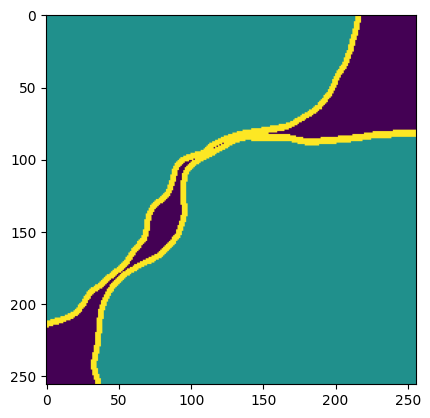

In [43]:
plt.imshow(np.argmax(y[0], axis=-1))

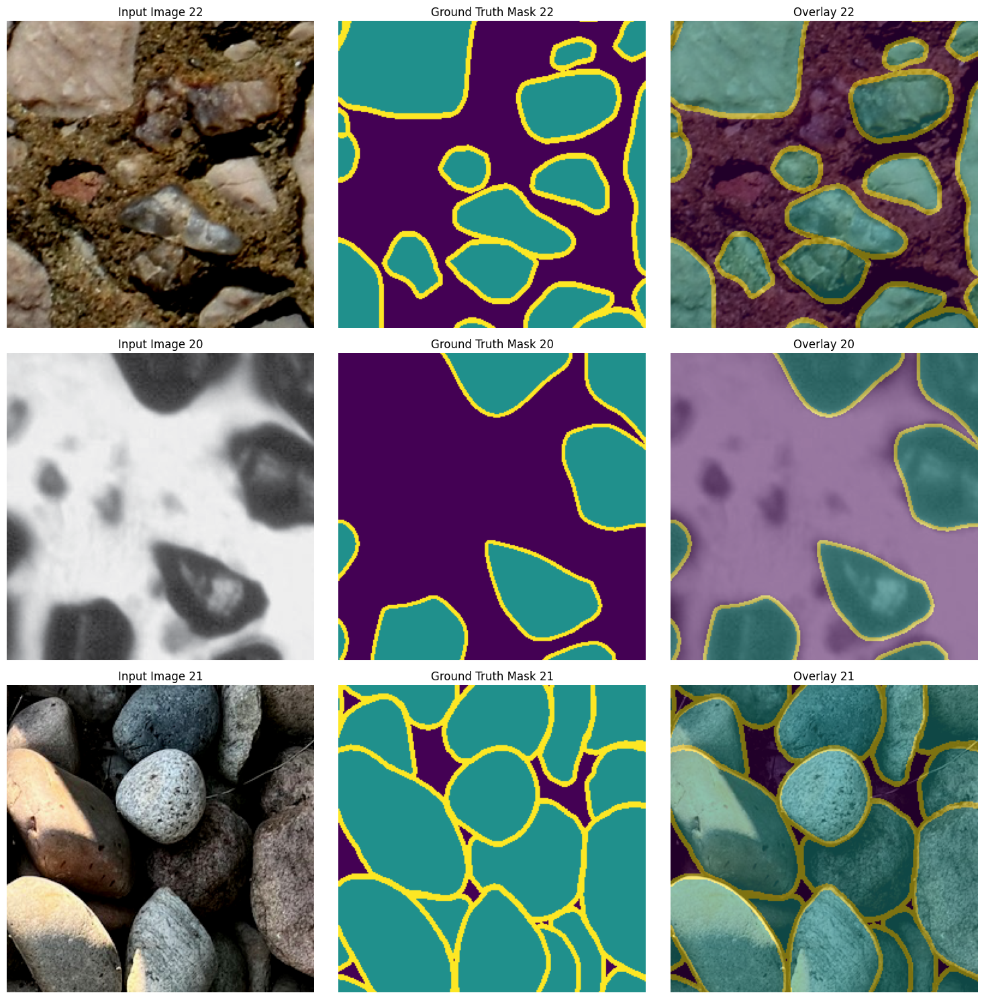

In [44]:
def visualize_generator_output(generator, num_samples=3):
    """Visualize samples from a data generator"""
    X, y = generator[0]  # Get first batch

    # Handle different input formats
    if isinstance(X, list):
        X = X[0]  # Take first element if it's a list
    elif isinstance(X, dict):
        X = next(iter(X.values()))  # Take first value if it's a dict

    # Select a few samples to display
    indices = np.random.choice(X.shape[0], min(num_samples, X.shape[0]), replace=False)

    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

    for i, idx in enumerate(indices):
        # Display input image
        axes[i, 0].imshow(X[idx])
        axes[i, 0].set_title(f"Input Image {idx}")
        axes[i, 0].axis('off')

        # Display ground truth mask (colored by class)
        mask_display = np.argmax(y[idx], axis=-1)
        axes[i, 1].imshow(mask_display, cmap='viridis')
        axes[i, 1].set_title(f"Ground Truth Mask {idx}")
        axes[i, 1].axis('off')

        # Display overlay
        axes[i, 2].imshow(X[idx])
        axes[i, 2].imshow(mask_display, alpha=0.5, cmap='viridis')
        axes[i, 2].set_title(f"Overlay {idx}")
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Use the function
visualize_generator_output(train_generator)

In [45]:
from keras.optimizers import Adam
import tensorflow as tf

# Create a standard U-Net with default parameters
# model = create_unet()

# Create a smaller U-Net for faster training
model = create_unet(filters_base=8, depth=4)

# Create a U-Net for different input dimensions
# custom_unet = create_unet(input_shape=(512, 512, 3), filters_base=32)

# Compile the model
model.compile(optimizer=Adam(), loss=weighted_crossentropy, metrics=["accuracy"])

In [46]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 256, 256, 8)    │            224 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 256, 256, 8)    │             32 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 256, 256, 8)    │            584 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 256, 256, 8)    │             32 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 128, 128, 8)    │              0 │ batch_normalization_1… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 128, 128, 16)   │          1,168 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 128, 128, 16)   │             64 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 128, 128, 16)   │          2,320 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 128, 128, 16)   │             64 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 64, 64, 16)     │              0 │ batch_normalization_3… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 64, 64, 32)     │          4,640 │ max_pooling2d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 64, 64, 32)     │            128 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 64, 64, 32)     │          9,248 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_5     │ (None, 64, 64, 32)     │            128 │ conv2d_5[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_2      

 Total params: 135,691 (530.04 KB)

 Trainable params: 134,987 (527.29 KB)

 Non-trainable params: 704 (2.75 KB)

In [47]:
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=100
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(None, 256, 256, 3))
  warnings.warn(msg)


70/70 ━━━━━━━━━━━━━━━━━━━━ 39s 354ms/step - accuracy: 0.4272 - loss: 1.2448 - val_accuracy: 0.5295 - val_loss: 1.3258
Epoch 2/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 22s 312ms/step - accuracy: 0.5550 - loss: 1.0959 - val_accuracy: 0.5366 - val_loss: 1.3531
Epoch 3/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 21s 301ms/step - accuracy: 0.6366 - loss: 1.0206 - val_accuracy: 0.5805 - val_loss: 1.2905
Epoch 4/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 22s 310ms/step - accuracy: 0.6786 - loss: 0.9892 - val_accuracy: 0.6285 - val_loss: 1.1067
Epoch 5/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 22s 314ms/step - accuracy: 0.7064 - loss: 0.9596 - val_accuracy: 0.6308 - val_loss: 1.0523
Epoch 6/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 22s 312ms/step - accuracy: 0.7239 - loss: 0.9420 - val_accuracy: 0.7140 - val_loss: 0.9770
Epoch 7/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 21s 300ms/step - accuracy: 0.7326 - loss: 0.9375 - val_accuracy: 0.7432 - val_loss: 0.9715
Epoch 8/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 22s 312ms/step - accuracy: 0.7422 - loss: 0.9319 - val_accuracy

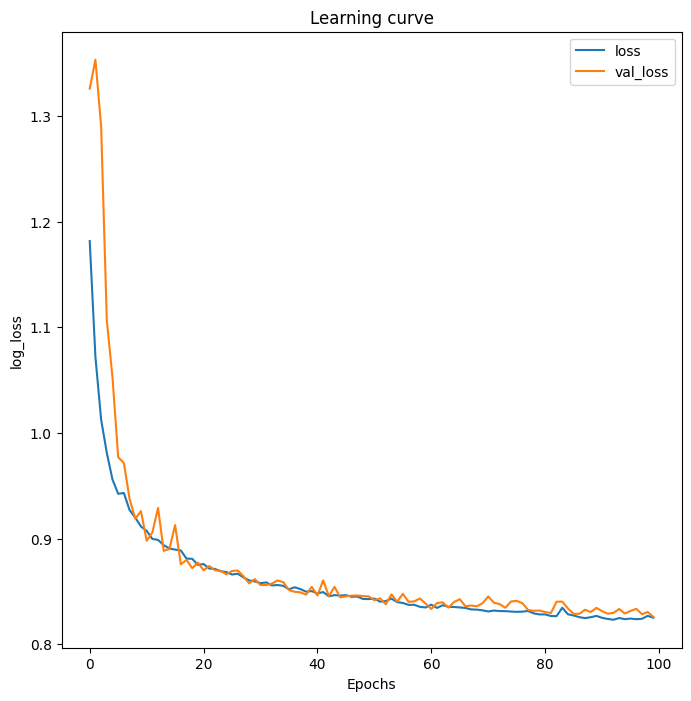

In [48]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(history.history['loss'], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

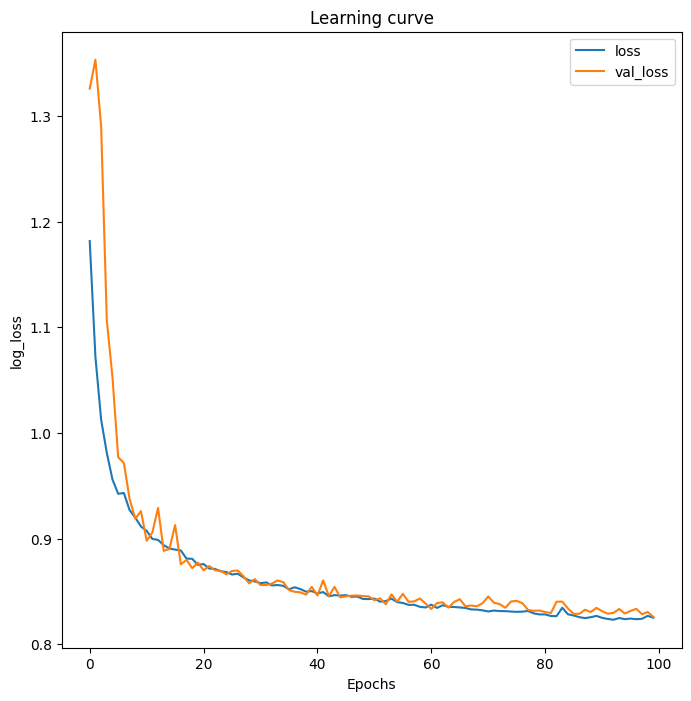

In [49]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(history.history['loss'], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

In [50]:
# Create test generator using the DataGenerator class
test_generator = DataGenerator(
    test_images,
    test_masks,
    batch_size=32,
    augment=False  # No augmentation for testing
)

# Evaluate model on test data
test_results = model.evaluate(test_generator, verbose=1)
print(f"Test Loss: {test_results[0]:.4f}")
print(f"Test Accuracy: {test_results[1]:.4f}")

35/35 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - accuracy: 0.8683 - loss: 0.8010
Test Loss: 0.8095
Test Accuracy: 0.8670


**Comment: Testing accurcay increased from 0.8383 to 0.8670 in the new model**

**We can also run predictions for new images using the model created:**

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(1, 256, 256, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 913ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


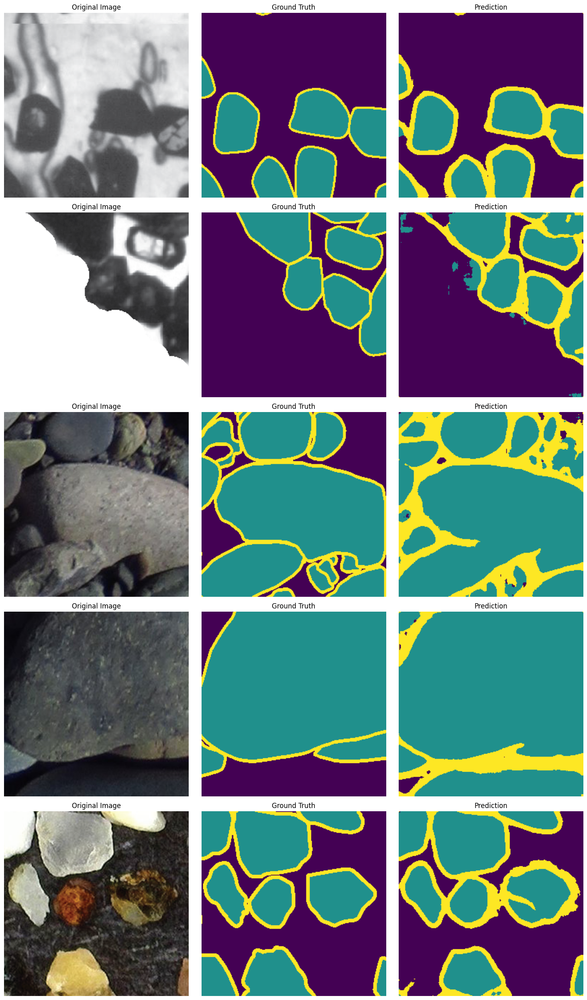

In [51]:
import matplotlib.pyplot as plt
import random

# Select a few random test images
num_samples = 5
sample_indices = random.sample(range(len(test_images)), num_samples)

# Create a figure for visualization
fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

for i, idx in enumerate(sample_indices):
    # Load image and mask
    image = np.array(Image.open(test_images[idx])).astype(np.float32) / 255.0
    mask = np.array(Image.open(test_masks[idx]))

    # Convert mask to one-hot encoding
    mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
    for c in range(3):
        mask_one_hot[:, :, c] = (mask == c).astype(np.float32)

    # Get model prediction
    image_batch = np.expand_dims(image, axis=0)
    prediction = model.predict(image_batch)[0]
    predicted_mask = np.argmax(prediction, axis=-1)

    # Display original image
    axes[i, 0].imshow(image)
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis('off')

    # Display ground truth mask
    axes[i, 1].imshow(np.argmax(mask_one_hot, axis=-1), vmin=0, vmax=2)
    axes[i, 1].set_title("Ground Truth")
    axes[i, 1].axis('off')

    # Display predicted mask
    axes[i, 2].imshow(predicted_mask, vmin=0, vmax=2)
    axes[i, 2].set_title("Prediction")
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

## Task 2

[This folder](https://drive.google.com/file/d/1-0I__CxYMoR1B70e95GHJogsdOTIbqmv/view?usp=sharing) contains (an image called 'ooid_test.jpg' and a folder called 'ooid_images' with a large image of [ooids](https://en.wikipedia.org/wiki/Ooid) and the corresponding segmentation mask. This type of image was not part of the training data that was provided previosuly to you. Your task is to
* (a) using the model you trained in task 1, run the image prediction on 'ooid_test.jpg' and (qualitatively) assess the result.
* (b) break up the image and the mask in the 'ooid_images' folder into patches and fine tune the model you trained in task 1 so that it works better with ooids. Re-run the prediction for 'ooid_test.jpg' and compare the result with what you got without fine tuning.

You can download the folder with the data using the code in the cell below.

In [52]:
import gdown
gdown.download('https://drive.google.com/uc?id=1-0I__CxYMoR1B70e95GHJogsdOTIbqmv', 'ooids.zip')

Downloading...
From (original): https://drive.google.com/uc?id=1-0I__CxYMoR1B70e95GHJogsdOTIbqmv
From (redirected): https://drive.google.com/uc?id=1-0I__CxYMoR1B70e95GHJogsdOTIbqmv&confirm=t&uuid=c59d271b-c121-4337-90d7-8f67011fb5f3
To: /content/ooids.zip
100%|██████████| 46.8M/46.8M [00:00<00:00, 167MB/s]


'ooids.zip'

In [53]:
!unzip ooids.zip

Archive:  ooids.zip
   creating: ooid_images/
  inflating: ooid_images/23-OZRC-B5-60m PPL_mask.png  
  inflating: __MACOSX/ooid_images/._23-OZRC-B5-60m PPL_mask.png  
  inflating: ooid_images/.DS_Store   
  inflating: __MACOSX/ooid_images/._.DS_Store  
  inflating: ooid_images/23-OZRC-B5-60m PPL_image.png  
  inflating: __MACOSX/ooid_images/._23-OZRC-B5-60m PPL_image.png  
  inflating: ooid_test.jpg           
  inflating: __MACOSX/._ooid_test.jpg  


100%|██████████| 9/9 [00:07<00:00,  1.14it/s]


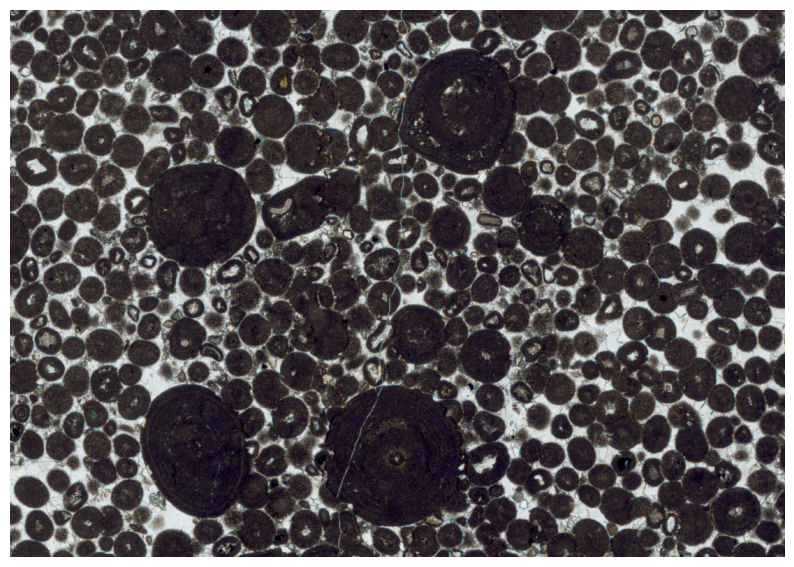

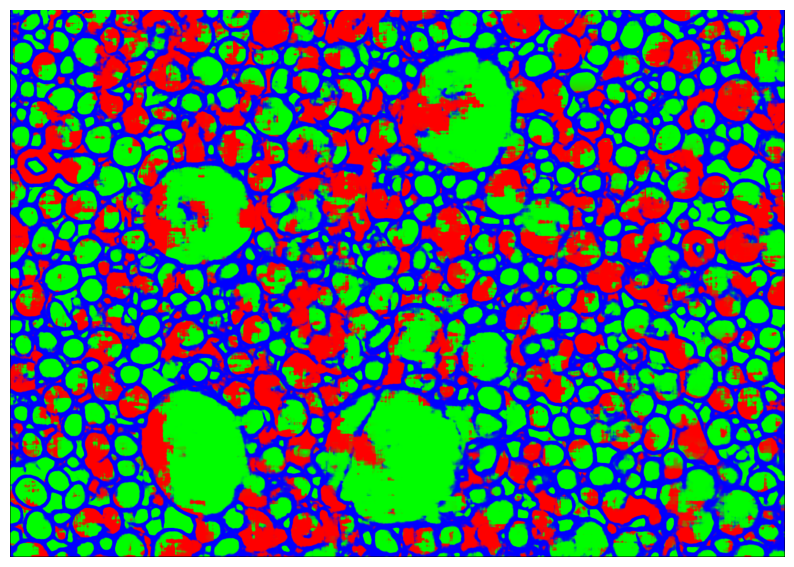

In [58]:
fname = 'ooid_test.jpg'

fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(np.array(Image.open(fname)))
plt.axis('off')

predicted_image = predict_large_image(fname, model)
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(predicted_image)
plt.axis('off')
plt.show()

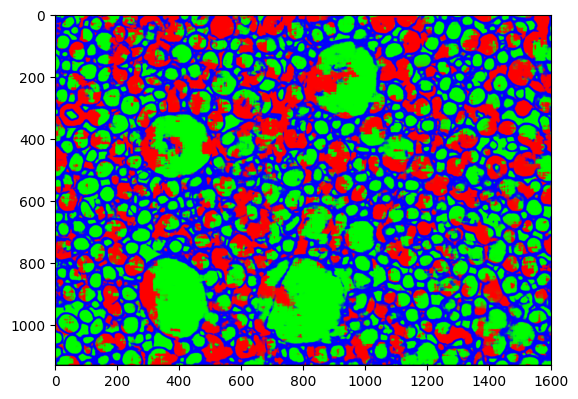

In [59]:
plt.imshow(predicted_image)

# **Task 2b**

In [60]:
def patchify_training_data(input_dir, patch_dir, patch_size=256, stride=128):
    """
    Extracts patches from training images and labels, and saves them to the specified directory.

    Parameters
    ----------
    input_dir : str
        The directory containing the input images and labels.
    patch_dir : str
        The directory where the patches will be saved.

    Returns
    -------
    tuple
        A tuple containing the paths to the directories where the image patches and label patches are saved.
    """
    from skimage.util import view_as_windows

    if not os.path.exists(input_dir):
        print(f"Warning: The directory {input_dir} does not exist.")
        return

    images = sorted(glob(input_dir + "*image*"))
    labels = sorted(glob(input_dir + "*mask*"))

    if not images or not labels:
        print(f"Warning: No files containing 'image' or 'mask' found in {input_dir}.")
        return

    # Create directories for patches
    patches_dir = os.path.join(patch_dir, "Patches")
    images_dir = os.path.join(patches_dir, "images")
    labels_dir = os.path.join(patches_dir, "labels")
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)

    start_no = 0
    for image_path in tqdm(images):
        # Load the image
        img = np.array(Image.open(image_path))

        # Handle different image formats
        if len(img.shape) == 2:  # Convert grayscale to RGB
            img = np.stack((img,) * 3, axis=-1)

        # Extract patches
        patches = view_as_windows(
            img,
            (patch_size, patch_size, 3),
            step=stride
        )

        # Reshape to list of patches (flatten the first two dimensions into a single dimension)
        patches = patches.reshape(-1, patch_size, patch_size, 3)

        # Save patches
        for i, patch in enumerate(patches):
            imname = os.path.join(images_dir, f'im{start_no + i:03d}.png')
            Image.fromarray(patch.astype(np.uint8)).save(imname)

        start_no += len(patches)

    start_no = 0
    for mask_path in tqdm(labels):
        # Load the mask
        mask = np.array(Image.open(mask_path))

        # Handle different mask formats
        if len(mask.shape) == 3 and mask.shape[2] > 1:
            mask = mask[:,:,0]  # Take only first channel

        mask = mask[:,:,np.newaxis] if len(mask.shape) == 3 else mask[:,:,np.newaxis]

        # Extract patches
        patches = view_as_windows(
            mask,
            (patch_size, patch_size, 1),
            step=stride
        )

        # Reshape to list of patches (flatten the first two dimensions into a single dimension)
        patches = patches.reshape(-1, patch_size, patch_size, 1)

        # Save patches
        for i, patch in enumerate(patches):
            imname = os.path.join(labels_dir, f'im{start_no + i:03d}.png')
            Image.fromarray(patch[:,:,0].astype(np.uint8)).save(imname)

        start_no += len(patches)

    return images_dir, labels_dir

In [61]:
from PIL import Image
from glob import glob

Image.MAX_IMAGE_PIXELS = None  # Remove image size limit

input_dir = '/content/ooid_images/'
patch_dir = '/content/ooid_images/'
images_dir, labels_dir = patchify_training_data(input_dir, patch_dir)

100%|██████████| 1/1 [00:02<00:00,  2.35s/it]


Checking the patches

Sample 1: /content/ooid_images/Patches/images/im345.png
Sample 2: /content/ooid_images/Patches/images/im915.png
Sample 3: /content/ooid_images/Patches/images/im854.png
Sample 4: /content/ooid_images/Patches/images/im733.png
Sample 5: /content/ooid_images/Patches/images/im1153.png


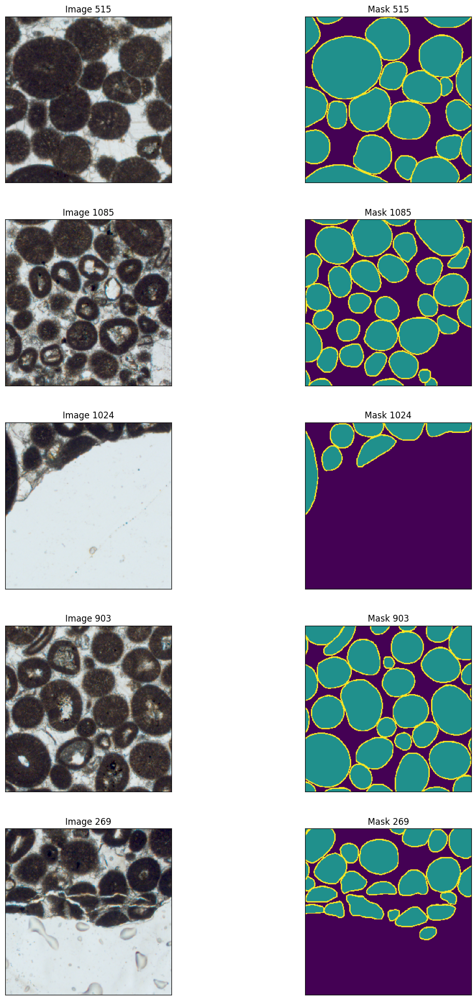

In [62]:
import cv2
import random
from glob import glob

images = sorted(glob(patch_dir + "Patches/images/*.png"))
labels = sorted(glob(patch_dir + "Patches/labels/*.png"))

# Select 5 random indices from the images list
random_indices = random.sample(range(len(images)), 5)

# Create a figure with 5 rows and 2 columns
fig, axes = plt.subplots(5, 2, figsize=(12, 20))
fig.tight_layout(pad=3.0)

# Loop through the random indices
for i, idx in enumerate(random_indices):
    # Get the image and mask filenames
    img_fname = images[idx]
    mask_fname = labels[idx]

    # Read the image and mask
    img = cv2.imread(img_fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for proper display
    mask = cv2.imread(mask_fname, cv2.IMREAD_GRAYSCALE)
    mask = mask[:,:,np.newaxis]  # Add channel dimension

    # Display the image
    axes[i, 0].imshow(img)
    axes[i, 0].set_title(f"Image {idx}")
    axes[i, 0].set_xticks([])
    axes[i, 0].set_yticks([])

    # Display the mask
    axes[i, 1].imshow(mask, vmin=0, vmax=2)
    axes[i, 1].set_title(f"Mask {idx}")
    axes[i, 1].set_xticks([])
    axes[i, 1].set_yticks([])

    # Print the filename for reference
    print(f"Sample {i+1}: {img_fname}")

plt.show()

In [63]:
# First randomly select a fraction of all images to use
total_subset_size = int(len(images)/1) # small enough that training takes a few minutes only
# total_subset_size = int(len(images)/1) # only use this if you are willing to wait ~40 minutes
subset_idx = np.random.choice(np.arange(len(images)), size=total_subset_size, replace=False)
subset_images = np.array(images)[subset_idx]
subset_labels = np.array(labels)[subset_idx]

# Split the subset into training (50%), validation (25%), and test (25%)
train_idx = np.random.choice(np.arange(len(subset_images)), size=int(total_subset_size/2), replace=False)
remaining_idx = np.setdiff1d(np.arange(len(subset_images)), train_idx)
val_idx = np.random.choice(remaining_idx, size=int(total_subset_size/4), replace=False)
test_idx = np.setdiff1d(remaining_idx, val_idx)

# Create arrays of training, validation, and test files
train_images = subset_images[train_idx]
val_images = subset_images[val_idx]
test_images = subset_images[test_idx]

train_masks = subset_labels[train_idx]
val_masks = subset_labels[val_idx]
test_masks = subset_labels[test_idx]

**Using all training images in this scenario**

In [64]:
len(train_images)

585

**Also applying more albumentations**

[]

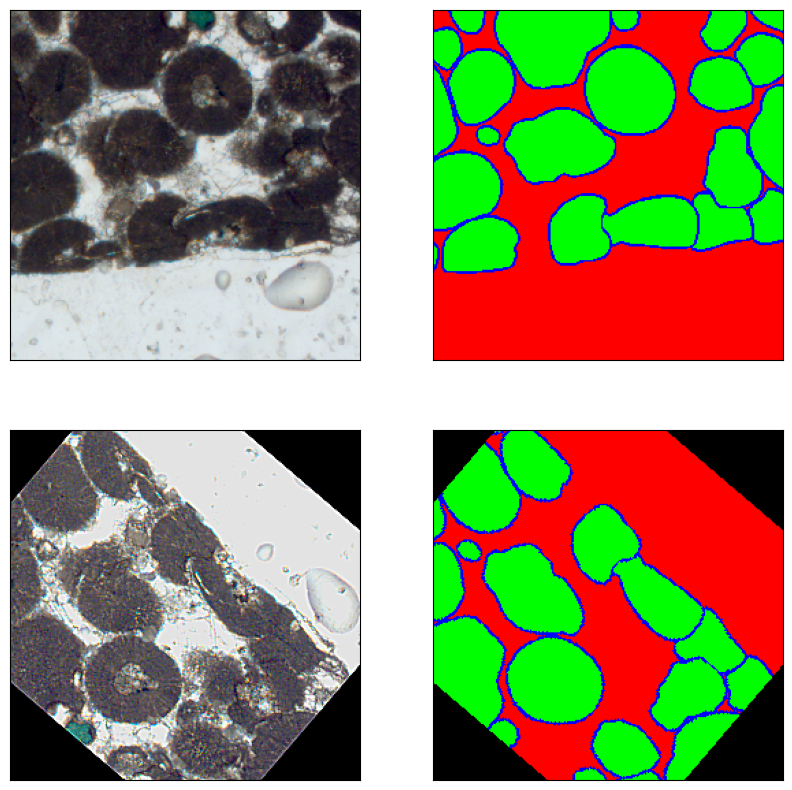

In [65]:
import albumentations as A
from PIL import Image

ind = 400
# Load image
image = np.array(Image.open(train_images[ind]))
# Load mask
mask = np.array(Image.open(train_masks[ind]))

# Convert mask to one-hot encoding
mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
for i in range(3):
    mask_one_hot[:, :, i] = (mask == i).astype(np.float32)

# Normalize image
image = image.astype(np.float32) / 255.0

# Define augmentation pipeline
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0, p=1.0),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5), A.RandomRotate90(p=0.5), A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=45, p=1.0), A.Sharpen(p=0.5),
    ])

# Apply augmentations
augmented = transform(image=image, mask=mask_one_hot)
augmented_image = augmented['image']
augmented_mask = augmented['mask']

# Display results
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes[0, 0].imshow(image)
axes[0, 0].set_xticks([]); axes[0, 0].set_yticks([])
axes[0, 1].imshow(mask_one_hot)
axes[0, 1].set_xticks([]); axes[0, 1].set_yticks([])
axes[1, 0].imshow(augmented_image)
axes[1, 0].set_xticks([]); axes[1, 0].set_yticks([])
axes[1, 1].imshow(augmented_mask)
axes[1, 1].set_xticks([]); axes[1, 1].set_yticks([])

In [66]:
from keras.utils import Sequence

# Define augmentation pipeline
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.7),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5)
])

class DataGenerator(Sequence): # Sequence is a keras class that is used to iterate over the data in
    def __init__(self, image_paths, mask_paths, batch_size=32, augment=True, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.batch_size = batch_size
        self.augment = augment
        if transform is not None:
            self.transform = transform
        elif augment:
            self.transform = A.Compose([
                A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.7),
                A.HorizontalFlip(p=0.5),
                A.VerticalFlip(p=0.5)
            ])
        else:
            self.transform = None

    def __len__(self):
        return len(self.image_paths) // self.batch_size

    def __getitem__(self, idx):
        batch_x = self.image_paths[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.mask_paths[idx * self.batch_size:(idx + 1) * self.batch_size]

        images = []
        masks = []

        for img_path, mask_path in zip(batch_x, batch_y):
            # Load image and mask
            image = np.array(Image.open(img_path))
            mask = np.array(Image.open(mask_path))

            # Convert mask to one-hot encoding
            mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
            for i in range(3):
                mask_one_hot[:, :, i] = (mask == i).astype(np.float32)

            # Normalize image
            image = image.astype(np.float32) / 255.0

            # Apply augmentation if enabled
            if self.augment:
                augmented = self.transform(image=image, mask=mask_one_hot)
                image = augmented['image']
                mask_one_hot = augmented['mask']

            images.append(image)
            masks.append(mask_one_hot)

        return np.array(images), np.array(masks)

In [67]:
# Create training and validation generators
train_generator = DataGenerator(
    train_images,
    train_masks,
    batch_size=32,
    augment=True,
    transform=transform
)

val_generator = DataGenerator(
    val_images,
    val_masks,
    batch_size=32,
    augment=False  # No augmentation for validation; no need to define a transform
)

In [68]:
# Get the first batch from the generator
X, y = train_generator[0]

# Print information about the output
print(f"Type of X: {type(X)}")
print(f"Shape of X: {np.shape(X)}")
print(f"Type of y: {type(y)}")
print(f"Shape of y: {y.shape}")

# Check data types and ranges
print(f"X dtype: {X.dtype if not isinstance(X, (list, dict)) else X[0].dtype if isinstance(X, list) else next(iter(X.values())).dtype}")
print(f"y dtype: {y.dtype}")
print(f"X min/max: {np.min(X)}/{np.max(X)}")
print(f"y min/max: {np.min(y)}/{np.max(y)}")

Type of X: <class 'numpy.ndarray'>
Shape of X: (32, 256, 256, 3)
Type of y: <class 'numpy.ndarray'>
Shape of y: (32, 256, 256, 3)
X dtype: float32
y dtype: float32
X min/max: 0.0/1.0
y min/max: 0.0/1.0


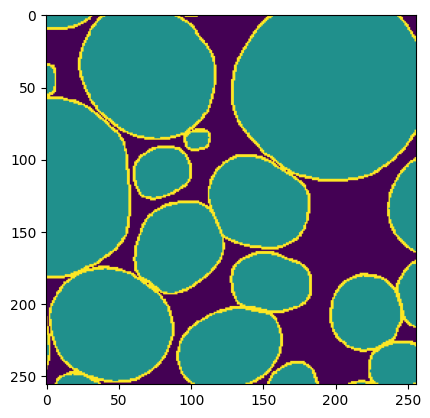

In [69]:
plt.imshow(np.argmax(y[0], axis=-1))

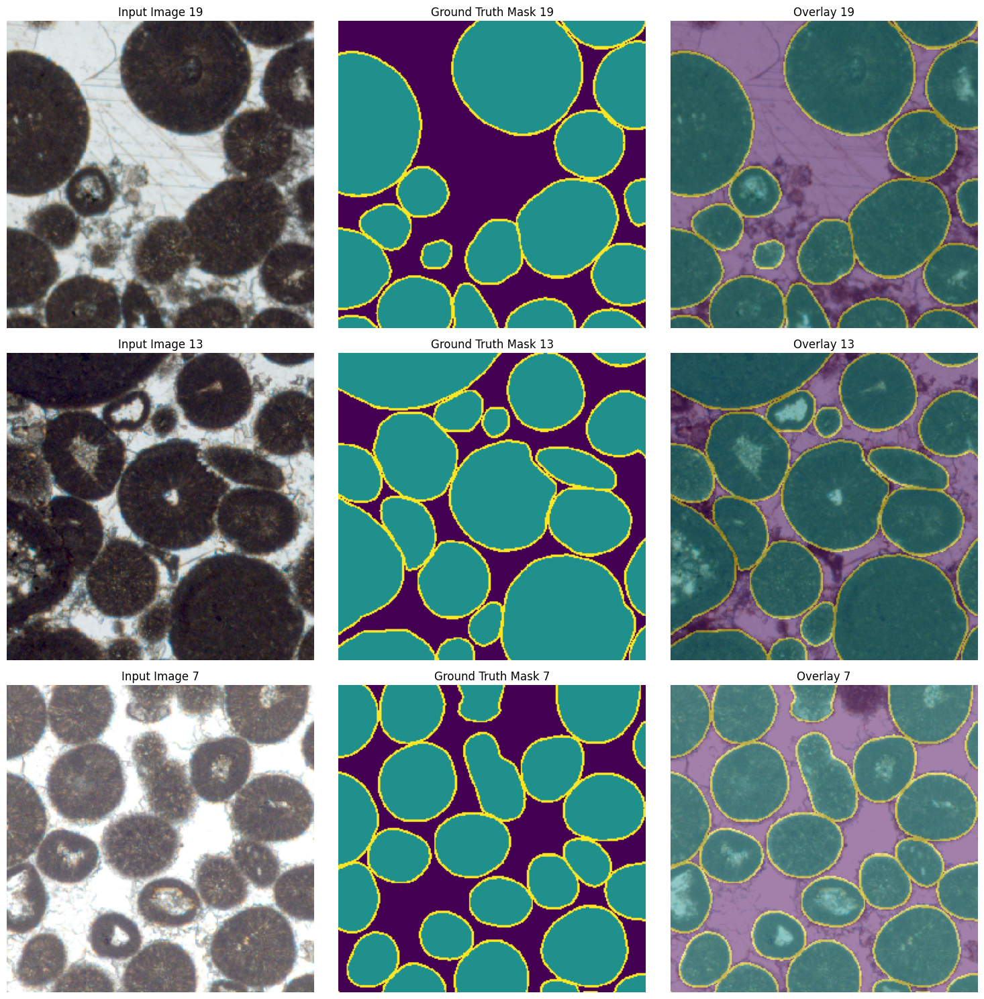

In [70]:
def visualize_generator_output(generator, num_samples=3):
    """Visualize samples from a data generator"""
    X, y = generator[0]  # Get first batch

    # Handle different input formats
    if isinstance(X, list):
        X = X[0]  # Take first element if it's a list
    elif isinstance(X, dict):
        X = next(iter(X.values()))  # Take first value if it's a dict

    # Select a few samples to display
    indices = np.random.choice(X.shape[0], min(num_samples, X.shape[0]), replace=False)

    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

    for i, idx in enumerate(indices):
        # Display input image
        axes[i, 0].imshow(X[idx])
        axes[i, 0].set_title(f"Input Image {idx}")
        axes[i, 0].axis('off')

        # Display ground truth mask (colored by class)
        mask_display = np.argmax(y[idx], axis=-1)
        axes[i, 1].imshow(mask_display, cmap='viridis')
        axes[i, 1].set_title(f"Ground Truth Mask {idx}")
        axes[i, 1].axis('off')

        # Display overlay
        axes[i, 2].imshow(X[idx])
        axes[i, 2].imshow(mask_display, alpha=0.5, cmap='viridis')
        axes[i, 2].set_title(f"Overlay {idx}")
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Use the function
visualize_generator_output(train_generator)

In [71]:
def weighted_crossentropy(y_true, y_pred):
    class_weights = tf.constant([[[[0.6, 1.0, 5.0]]]]) # increase the weight on the grains and the grain boundaries
    unweighted_losses = tf.nn.softmax_cross_entropy_with_logits(labels=y_true, logits=y_pred)
    weights = tf.reduce_sum(class_weights * y_true, axis=-1)
    weighted_losses = weights * unweighted_losses
    loss = tf.reduce_mean(weighted_losses)
    return loss

  # 0.6, 1.0, 5.0: weights for background, grain, and grain boundary classes

In [72]:
from keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose
from keras.layers import BatchNormalization, concatenate
from keras.models import Model

def create_unet(input_shape=(256, 256, 3), filters_base=16, depth=5):
    """
    Create a U-Net model with configurable parameters.

    Parameters:
    -----------
    input_shape : tuple
        Shape of input images (height, width, channels)
    filters_base : int
        Number of filters in the first layer, doubles with each depth level
    depth : int
        Number of depth levels in the U-Net

    Returns:
    --------
    keras.Model
        Compiled U-Net model
    """
    # Clear backend
    tf.keras.backend.clear_session()

    # Input layer
    inputs = Input(input_shape)

    # Store skip connections
    skip_connections = []

    # Encoder (contracting path)
    x = inputs
    for i in range(depth):
        filters = filters_base * (2**i)

        # Two convolution layers with batch normalization
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)

        # Save for skip connection
        skip_connections.append(x)

        # Max pooling except for the last layer
        if i < depth - 1:
            x = MaxPooling2D(pool_size=(2, 2))(x)

    # Decoder (expanding path)
    for i in range(depth-2, -1, -1):
        filters = filters_base * (2**i)

        # Upsampling
        x = Conv2DTranspose(filters, (3, 3), strides=(2, 2), padding='same')(x)

        # Concatenate with skip connection
        x = concatenate([x, skip_connections[i]])

        # Two convolution layers with batch normalization
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
        x = BatchNormalization()(x)

    # Output layer
    outputs = Conv2D(3, (1, 1), activation='softmax')(x)

    # Create model
    model = Model(inputs=[inputs], outputs=[outputs])

    return model

**Now creating the improved model for ooids**

In [73]:
from keras.optimizers import Adam
import tensorflow as tf

# Create a standard U-Net with default parameters
# model = create_unet()

# Create a smaller U-Net for faster training
model = create_unet(filters_base=8, depth=4)

# Create a U-Net for different input dimensions
# custom_unet = create_unet(input_shape=(512, 512, 3), filters_base=32)

# Compile the model
model.compile(optimizer=Adam(), loss=weighted_crossentropy, metrics=["accuracy"])

In [74]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 256, 256, 8)    │            224 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 256, 256, 8)    │             32 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 256, 256, 8)    │            584 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 256, 256, 8)    │             32 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 128, 128, 8)    │              0 │ batch_normalization_1… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 128, 128, 16)   │          1,168 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 128, 128, 16)   │             64 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 128, 128, 16)   │          2,320 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 128, 128, 16)   │             64 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 64, 64, 16)     │              0 │ batch_normalization_3… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 64, 64, 32)     │          4,640 │ max_pooling2d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 64, 64, 32)     │            128 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 64, 64, 32)     │          9,248 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_5     │ (None, 64, 64, 32)     │            128 │ conv2d_5[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_2      

 Total params: 135,691 (530.04 KB)

 Trainable params: 134,987 (527.29 KB)

 Non-trainable params: 704 (2.75 KB)

In [75]:
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=100
)

Epoch 1/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 22s 422ms/step - accuracy: 0.5898 - loss: 1.1689 - val_accuracy: 0.8593 - val_loss: 1.2540
Epoch 2/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 314ms/step - accuracy: 0.7762 - loss: 0.9456 - val_accuracy: 0.8561 - val_loss: 1.1942
Epoch 3/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 340ms/step - accuracy: 0.8067 - loss: 0.8739 - val_accuracy: 0.3707 - val_loss: 1.3680
Epoch 4/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 314ms/step - accuracy: 0.8254 - loss: 0.8494 - val_accuracy: 0.8284 - val_loss: 1.1162
Epoch 5/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 357ms/step - accuracy: 0.8465 - loss: 0.8341 - val_accuracy: 0.7569 - val_loss: 1.1084
Epoch 6/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 308ms/step - accuracy: 0.8621 - loss: 0.8133 - val_accuracy: 0.8283 - val_loss: 1.0630
Epoch 7/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 342ms/step - accuracy: 0.8676 - loss: 0.7947 - val_accuracy: 0.6239 - val_loss: 1.2449
Epoch 8/100
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 321ms/step - accuracy: 0.8747 - loss: 0.7893 - val_acc

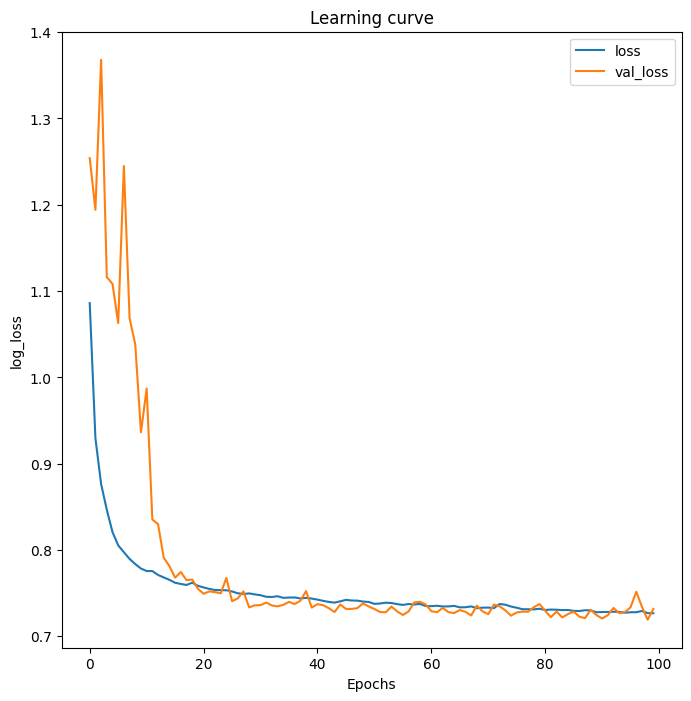

In [76]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(history.history['loss'], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

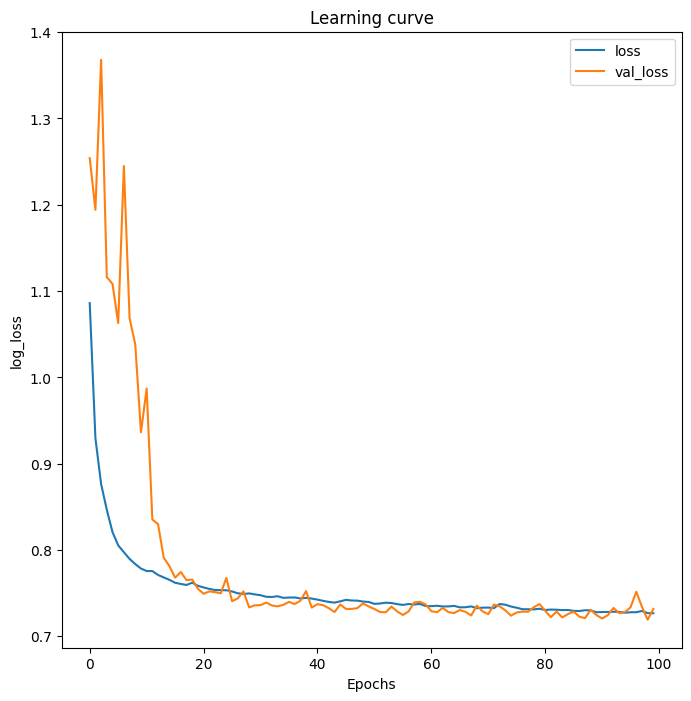

In [77]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(history.history['loss'], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

In [78]:
# Create test generator using the DataGenerator class
test_generator = DataGenerator(
    test_images,
    test_masks,
    batch_size=32,
    augment=False  # No augmentation for testing
)

# Evaluate model on test data
test_results = model.evaluate(test_generator, verbose=1)
print(f"Test Loss: {test_results[0]:.4f}")
print(f"Test Accuracy: {test_results[1]:.4f}")

9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 174ms/step - accuracy: 0.9121 - loss: 0.7435
Test Loss: 0.7442
Test Accuracy: 0.9111


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 911ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


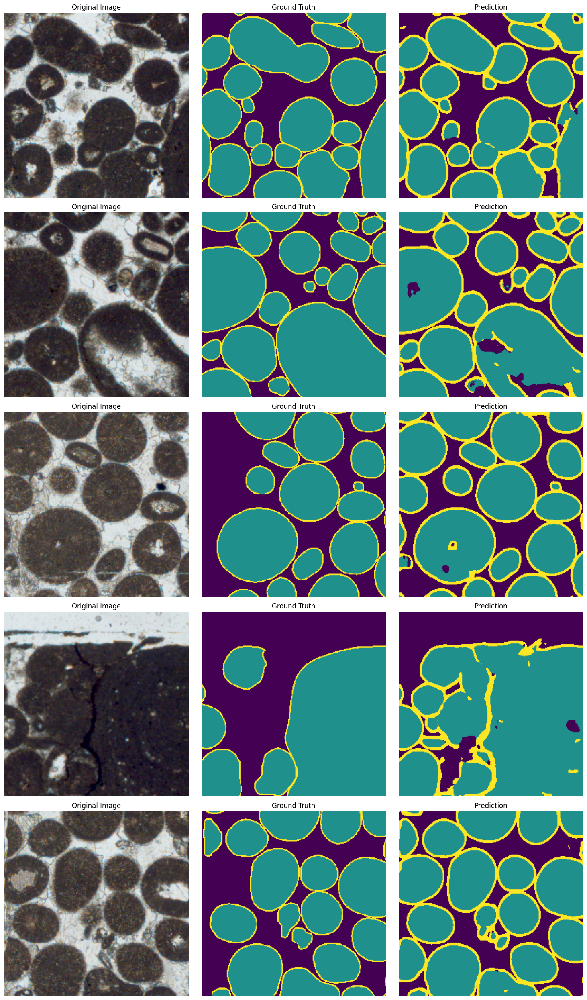

In [79]:
import matplotlib.pyplot as plt
import random

# Select a few random test images
num_samples = 5
sample_indices = random.sample(range(len(test_images)), num_samples)

# Create a figure for visualization
fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))

for i, idx in enumerate(sample_indices):
    # Load image and mask
    image = np.array(Image.open(test_images[idx])).astype(np.float32) / 255.0
    mask = np.array(Image.open(test_masks[idx]))

    # Convert mask to one-hot encoding
    mask_one_hot = np.zeros((256, 256, 3), dtype=np.float32)
    for c in range(3):
        mask_one_hot[:, :, c] = (mask == c).astype(np.float32)

    # Get model prediction
    image_batch = np.expand_dims(image, axis=0)
    prediction = model.predict(image_batch)[0]
    predicted_mask = np.argmax(prediction, axis=-1)

    # Display original image
    axes[i, 0].imshow(image)
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis('off')

    # Display ground truth mask
    axes[i, 1].imshow(np.argmax(mask_one_hot, axis=-1), vmin=0, vmax=2)
    axes[i, 1].set_title("Ground Truth")
    axes[i, 1].axis('off')

    # Display predicted mask
    axes[i, 2].imshow(predicted_mask, vmin=0, vmax=2)
    axes[i, 2].set_title("Prediction")
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

In [80]:
# can save the model using 'model.save'
model.save("unet_model.keras")

Testing the fine-tunned model on the ooids image

100%|██████████| 9/9 [00:07<00:00,  1.20it/s]


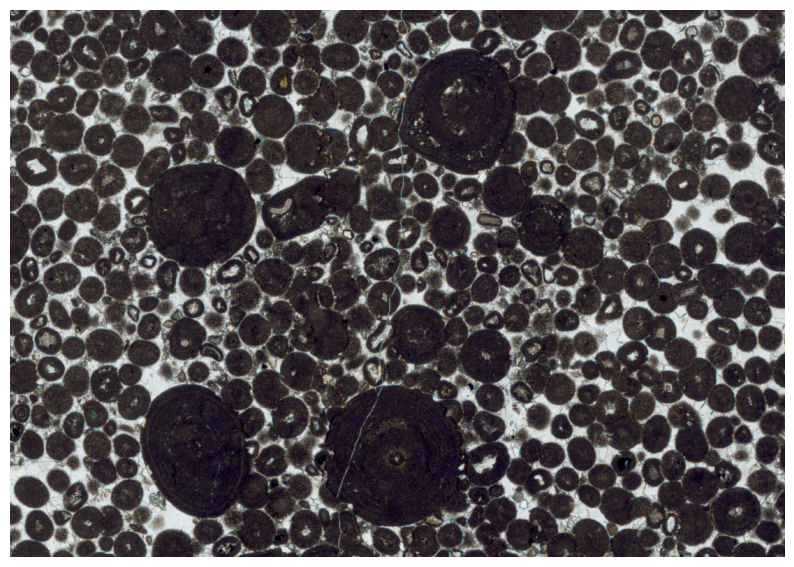

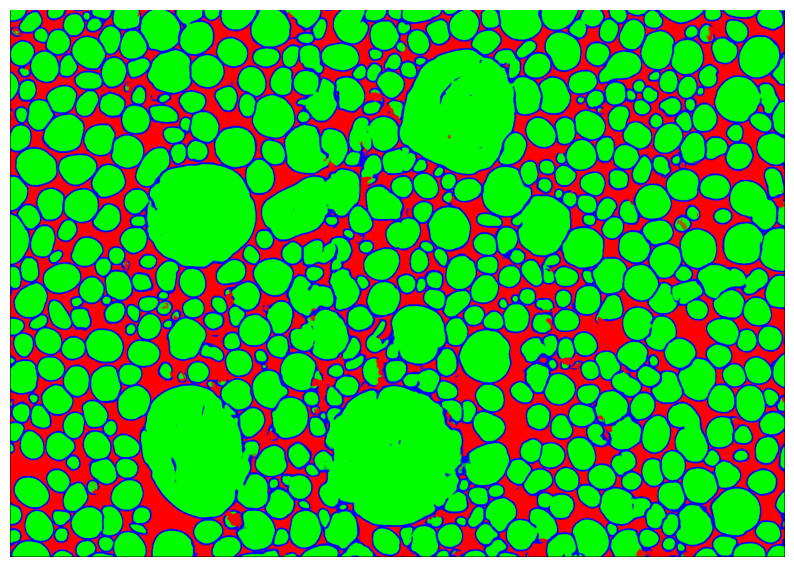

In [81]:
fname = 'ooid_test.jpg'

fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(np.array(Image.open(fname)))
plt.axis('off')

predicted_image_2 = predict_large_image(fname, model)
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(predicted_image_2)
plt.axis('off')
plt.show()

**Comment: The fine tunned model produces a much better segmentation of the ooids**

General Visualizations:

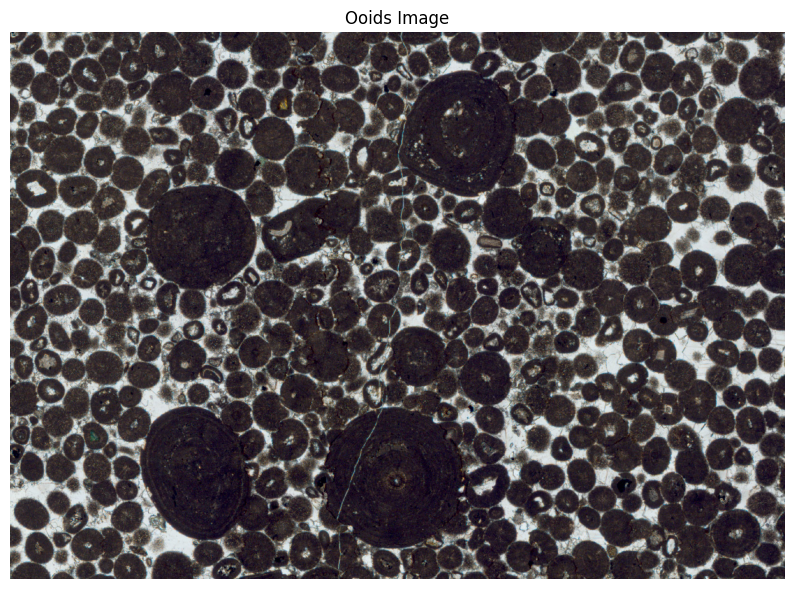

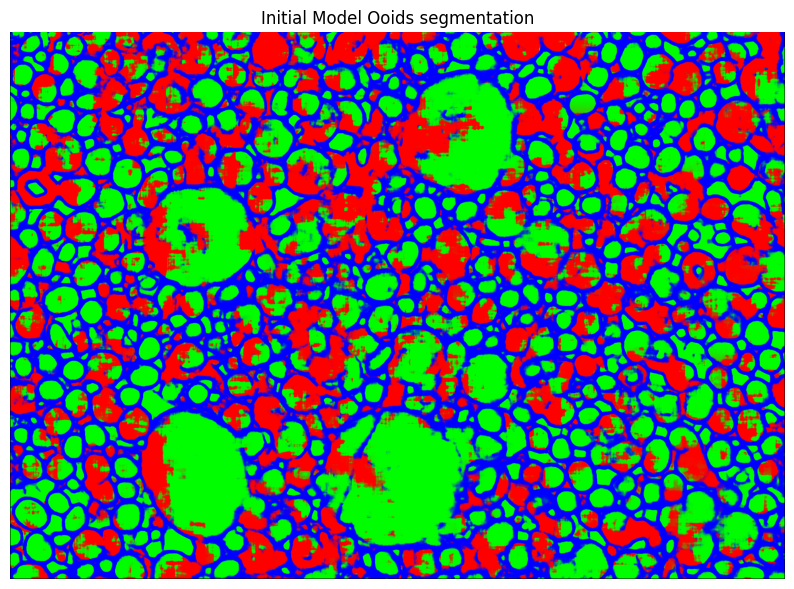

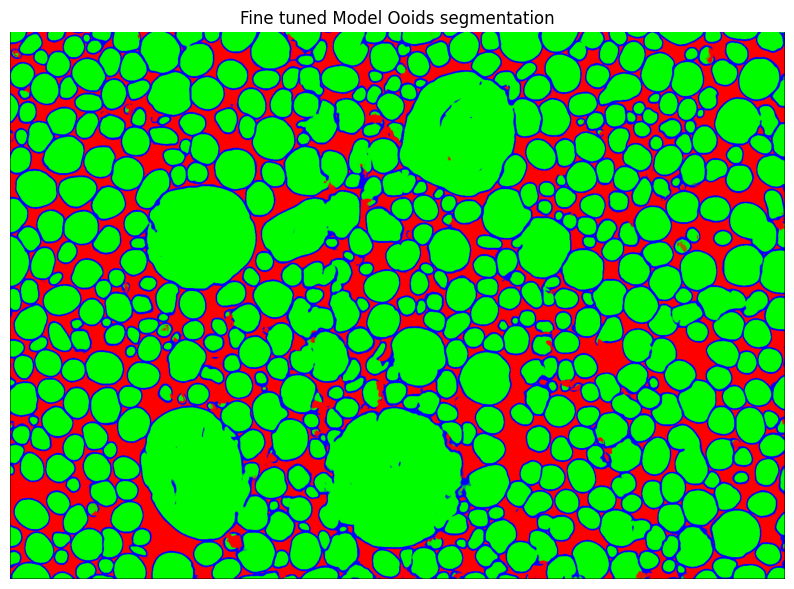

In [85]:
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(np.array(Image.open(fname)))
plt.title("Ooids Image")
plt.axis('off')

fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(predicted_image)
plt.title("Initial Model Ooids segmentation")
plt.axis('off')

fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(predicted_image_2)
plt.title("Fine tuned Model Ooids segmentation")
plt.axis('off')
plt.show()